In [1]:
# Custom codes are used for this study.

# Import the libraries

In [2]:
import rdkit
import pandas as pd
import sys
import math
import collections
from math import log
from scipy import stats
from rdkit import Chem, DataStructs
import numpy as np
import seaborn as sns #pip install seaborn
import matplotlib #pip install matplotlib
import matplotlib.pyplot as plt
import sklearn #pip install scikit-learn
from sklearn.decomposition import PCA
from collections import Counter # count freq
from operator import itemgetter
from rdkit.Chem.Scaffolds import MurckoScaffold
from rdkit.Chem.Fingerprints import FingerprintMols
from rdkit.Chem import Descriptors
from rdkit.Chem import AllChem
from rdkit.Chem import Draw
from matplotlib_venn import venn2
from matplotlib_venn import venn2_unweighted  
from matplotlib import gridspec
import matplotlib.backend_tools as mpt
from matplotlib.offsetbox import OffsetImage,AnnotationBbox,TextArea
import matplotlib.backend_tools as mpt
import matplotlib.backends
from tqdm import tqdm
import numpy
from scipy.cluster.hierarchy import dendrogram, linkage

In [3]:
from matplotlib.offsetbox import OffsetImage,AnnotationBbox,TextArea
import pylab
from pylab import xticks
from mpl_toolkits import mplot3d
from matplotlib import (
    _api, backend_tools as tools, cbook, colors, text,
    transforms, widgets, get_backend, is_interactive, rcParams)
import matplotlib_tools as mpt
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import matplotlib.patches as mpatches
# pip install lazypredict-nightly yaparak sorun çozuldu
import lazypredict
import lazypredict.Supervised
from lazypredict.Supervised import LazyClassifier
from lazypredict.Supervised import LazyRegressor
from sklearn.utils import all_estimators
from sklearn.model_selection import train_test_split
import glob
import random
import base64
import pandas as pd

from PIL import Image
from io import BytesIO
from IPython.display import HTML

In [4]:
from rdkit.Chem import rdDepictor
rdDepictor.SetPreferCoordGen(True)

In [5]:
print("User Current Version:-", sys.version)

User Current Version:- 3.12.8 | packaged by Anaconda, Inc. | (main, Dec 11 2024, 16:48:34) [MSC v.1929 64 bit (AMD64)]


# Import Porphyrin Dataset 

In [6]:
porph = pd.read_csv('porphyrin.csv')
porph.head()

,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,Standard Relation,...,Target Type,Document ChEMBL ID,Source ID,Source Description,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value
0,CHEMBL1325592,PROTOPORPHYRIN,-1.00,562.67,2.00,7.50,SID50106857,C=CC1=C(C)c2cc3[nH]c(cc4nc(cc5[nH]c(cc1n2)c(C)...,Potency,'=',...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,CHEMBL441738,AFAMELANOTIDE,4.00,1646.87,NaN,NaN,NDP-MSH,CCCC[C@H](NC(=O)[C@H](CO)NC(=O)[C@H](Cc1ccc(O)...,EC50,'=',...,SINGLE PROTEIN,CHEMBL1136069,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,CHEMBL3307715,NaN,NaN,NaN
2,CHEMBL441738,AFAMELANOTIDE,4.00,1646.87,NaN,NaN,NDP-MSH,CCCC[C@H](NC(=O)[C@H](CO)NC(=O)[C@H](Cc1ccc(O)...,EC50,'=',...,SINGLE PROTEIN,CHEMBL1136069,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,CHEMBL3307715,NaN,NaN,NaN
3,CHEMBL71,CHLORPROMAZINE,4.00,318.87,0.00,4.89,Chlorpromazine,CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21,IC50,'=',...,SINGLE PROTEIN,CHEMBL1136167,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,NaN,NaN,NaN,NaN
4,CHEMBL500593,NaN,NaN,622.72,2.00,6.31,6,C=Cc1c(C)c2cc3nc(c4c5[nH]c(cc6nc(cc1[nH]2)C(C)...,ED50,'=',...,CELL-LINE,CHEMBL1155723,1.00,Scientific Literature,J Nat Prod,2001.00,CHEMBL3308035,NaN,NaN,NaN


In [7]:
porph['Smiles'][0]

'C=CC1=C(C)c2cc3[nH]c(cc4nc(cc5[nH]c(cc1n2)c(C)c5CCC(=O)O)C(CCC(=O)O)=C4C)c(C)c3C=C'

In [43]:
porph['Assay Description'].unique().tolist()

['PUBCHEM_BIOASSAY: Confirmation qHTS Assay for Inhibitors of the Human Apurinic/apyrimidinic Endonuclease 1 (APE1). (Class of assay: confirmatory) [Related pubchem assays: 1705 (qHTS Validation Assay for Inhibitors of the Human Apurinic/apyrimidinic Endonuclease 1 (APE1) )',
 'Agonist activity on mouse melanocortin 1 receptor (mMC1R) stably expressed in HEK cells',
 'Compound was evaluated for its agonist activity on mouse melanocortin receptor 3 (mMC3R) stably expressed in HEK cells',
 'Inhibition of human Potassium channel HERG expressed in mammalian cells',
 'Cytotoxicity against human HCT8 cells after 72 hrs by SRB assay',
 'Cytotoxicity against human KB cells after 72 hrs by SRB assay',
 'Cytotoxicity against human A549 cells after 72 hrs by SRB assay',
 'Effective concentration required for intracellular cAMP accumulation by Melanocortin 5 receptor',
 'Effect of substituent bulk on telomerase inhibition at 25 uM',
 'Skin uptake in C3H mice bearing RIF tumors',
 'Minimal bacteria

In [44]:
len(porph) #12405 rows

12405

In [8]:
# Remove molecules related to porphyria disease found in dataset but not a porphyrin molecule itself!
molecule_ids_to_remove = [
    'CHEMBL1535', 'CHEMBL1222250', 'CHEMBL550348', 'CHEMBL71',
    'CHEMBL1201481', 'CHEMBL4297760', 'CHEMBL4594265', 'CHEMBL5275624', 'CHEMBL441738']

# Remove them !
porph = porph[~porph['Molecule ChEMBL ID'].isin(molecule_ids_to_remove)]

In [9]:
# number of molecules in the initial dataset
len(porph)

8084

In [10]:
# include only IC50 results
porph=porph[ porph['Standard Type'] == "IC50"]

In [11]:
len(porph)

778

In [12]:
# remove replicates
porph=porph[~porph.duplicated(['Molecule ChEMBL ID', 'Document ChEMBL ID'], keep='first')]

In [13]:
len(porph)

342

In [14]:
# remove missing values
porph=porph.dropna(subset=['Smiles'])

In [15]:
len(porph)

336

In [16]:
porph['Standard Type'].unique()

array(['IC50'], dtype=object)

In [17]:
porph['Standard Units'].unique() #only 1 diff types of activity unit values

array(['nM', 'ug.mL-1', nan], dtype=object)

In [18]:
porph= porph[(porph['Standard Units'] == 'nM') | (porph['Standard Units'].isna())]

In [19]:
len(porph)

317

In [21]:
porph['Assay Description'].unique().tolist()

['Inhibition of HIV-1 protease in 5%DMSO',
 'Cytotoxicity against human A549 cells assessed as reduction in cell viability incubated for 48 hrs by CCK-8 assay',
 'Phototoxicity against mouse B16-F10 cells assessed as reduction in cell viability incubated for 24 hrs followed by irradiated with 10 J/cm2 660 nanometer visible light and measured after 24 hrs hrs by CCK-8 assay',
 'Inhibition of HIV-1 protease in 10% fetal calf serum(FCS)',
 'Photosensitizing activity against human HeLa cells assessed as reduction in cell viability pre-incubated for 24 hrs followed by 15 mins exposure to 670 to 710 nm light at dose of 2.0 J/cm2 and measured 12 hrs after radiation by WST-8 assay',
 'Cytotoxicity against mouse B16-F10 cells assessed as reduction in cell viability measured after 72 hrs by MTT assay',
 'Inhibition of HIV-2 protease in 5%DMSO',
 'Cytotoxicity for relative cell viability compared to untreated control in Primary leukemic cells(PLC) by MTT assay',
 'Antitumor activity against human

In [22]:
# Assay types used...
porph['Assay Type'].unique().tolist()

['B', 'A', 'F', 'T', nan]

In [58]:
pd.set_option('display.max_rows', None)  # display all rows
pd.set_option('display.max_columns', None)  # display all columns

In [24]:
porph

,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,Standard Relation,Standard Value,Standard Units,pChEMBL Value,Data Validity Comment,Comment,Uo Units,Ligand Efficiency BEI,Ligand Efficiency LE,Ligand Efficiency LLE,Ligand Efficiency SEI,Potential Duplicate,Assay ChEMBL ID,Assay Description,Assay Type,BAO Format ID,BAO Label,Assay Organism,Assay Tissue ChEMBL ID,Assay Tissue Name,Assay Cell Type,Assay Subcellular Fraction,Assay Parameters,Assay Variant Accession,Assay Variant Mutation,Target ChEMBL ID,Target Name,Target Organism,Target Type,Document ChEMBL ID,Source ID,Source Description,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value
16,CHEMBL268410,NaN,NaN,1279.63,NaN,NaN,7,CC1=C(C(COC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3...,IC50,'=',5000.00,nM,5.30,NaN,NaN,UO_0000065,4.14,NaN,NaN,NaN,0.00,CHEMBL769355,Inhibition of HIV-1 protease in 5%DMSO,B,BAO_0000357,single protein format,Human immunodeficiency virus 1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CHEMBL243,Human immunodeficiency virus type 1 protease,Human immunodeficiency virus 1,SINGLE PROTEIN,CHEMBL1126254,1.00,Scientific Literature,J Med Chem,1992.00,NaN,NaN,NaN,NaN
39,CHEMBL4741802,NaN,NaN,813.95,3.00,7.97,3a,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O...,IC50,'=',179000.00,nM,NaN,Outside typical range,NaN,UO_0000065,NaN,NaN,NaN,NaN,0.00,CHEMBL4709509,Cytotoxicity against human A549 cells assessed...,A,BAO_0000219,cell-based format,Homo sapiens,NaN,NaN,A549,NaN,NaN,NaN,NaN,CHEMBL392,A549,Homo sapiens,CELL-LINE,CHEMBL4706542,1.00,Scientific Literature,Eur J Med Chem,2020.00,CHEMBL3307651,TIME = 48.0 hr,NaN,NaN
40,CHEMBL2111186,TALAPORFIN,3.00,711.77,3.00,5.95,Talaporfin,C=Cc1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O)O)C(=O)...,IC50,'=',14000.00,nM,4.85,NaN,NaN,UO_0000065,NaN,NaN,NaN,NaN,0.00,CHEMBL4709516,Phototoxicity against mouse B16-F10 cells asse...,F,BAO_0000219,cell-based format,Mus musculus,NaN,NaN,B16-F10,NaN,NaN,NaN,NaN,CHEMBL612656,B16-F10,Mus musculus,CELL-LINE,CHEMBL4706542,1.00,Scientific Literature,Eur J Med Chem,2020.00,CHEMBL3307762,TIME = 48.0 hr,NaN,NaN
41,CHEMBL4744564,NaN,NaN,698.86,2.00,9.01,1,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)O)c4[nH]c(cc5...,IC50,'=',2650.00,nM,5.58,NaN,NaN,UO_0000065,NaN,NaN,NaN,NaN,0.00,CHEMBL4709516,Phototoxicity against mouse B16-F10 cells asse...,F,BAO_0000219,cell-based format,Mus musculus,NaN,NaN,B16-F10,NaN,NaN,NaN,NaN,CHEMBL612656,B16-F10,Mus musculus,CELL-LINE,CHEMBL4706542,1.00,Scientific Literature,Eur J Med Chem,2020.00,CHEMBL3307762,TIME = 48.0 hr,NaN,NaN
60,CHEMBL12659,NaN,NaN,630.70,2.00,3.53,12,CC1=C(C(O)CO)c2cc3nc(cc4[nH]c(cc5[nH]c(cc1n2)c...,IC50,'>',200000.00,nM,NaN,Outside typical range,NaN,UO_0000065,NaN,NaN,NaN,NaN,0.00,CHEMBL769358,Inhibition of HIV-1 protease in 10% fetal calf...,B,BAO_0000357,single protein format,Human immunodeficiency virus 1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CHEMBL243,Human immunodeficiency virus type 1 protease,Human immunodeficiency virus 1,SINGLE PROTEIN,CHEMBL1126254,1.00,Scientific Literature,J Med Chem,1992.00,NaN,NaN,NaN,NaN
95,CHEMBL3400527,NaN,NaN,765.91,2.00,9.33,4,CCC1=C(C)c2cc3[nH]c(cc4nc(c(CC(=O)OC)c5[nH]c(c...,IC50,'=',170.00,nM,6.77,NaN,NaN,UO_0000065,NaN,NaN,NaN,NaN,0.00,CHEMBL3406962,Photosensitizing activity against human HeLa c...,F,BAO_0000219,cell-based format,Homo sapiens,NaN,NaN,HeLa,NaN,NaN,NaN,NaN,CHEMBL399,HeLa,Homo sapiens,CELL-LINE,CHEMBL3399919,1.00,Scientific Literature,Bioorg Med Chem,2015.00,CHEMBL3308376,NaN,NaN,NaN
163,CHEMBL65606,TMPYP4,NaN,678.84,2.00,6.62,TMPyP4,C[n+]1ccc(-c2c3nc(c(-c4cc[n+](C)cc4)c4ccc([nH]...,IC50,'=',77010.00,nM,4.11,NaN,NaN,UO_0000065,NaN,NaN,NaN,NaN,0.00,CHEMBL4732474,Cytotoxicity against mouse B16-F10 cells asses...,F,BAO_0000219,cell-based format,Mus musculus,NaN,NaN,B16-F10,NaN,NaN,NaN,NaN,CHEMBL612656,B16-F10,Mus musculus,CELL-LINE,CHEMBL4732026,1.00,Scientific Literature,RSC Med Chem,2021.00,CHEMBL3307762,TIME = 72.0 hr,NaN,NaN
188,CH

In [20]:
porph=porph.reset_index()

In [21]:
len(porph)

317

In [27]:
porph.isnull().sum() #

index                           0
Molecule ChEMBL ID              0
Molecule Name                 286
Molecule Max Phase            306
Molecular Weight                0
#RO5 Violations                16
AlogP                          16
Compound Key                    0
Smiles                          0
Standard Type                   0
Standard Relation               5
Standard Value                  2
Standard Units                  2
pChEMBL Value                  51
Data Validity Comment         298
Comment                       310
Uo Units                        2
Ligand Efficiency BEI         288
Ligand Efficiency LE          292
Ligand Efficiency LLE         292
Ligand Efficiency SEI         292
Potential Duplicate             0
Assay ChEMBL ID                 0
Assay Description               0
Assay Type                      6
BAO Format ID                   6
BAO Label                       6
Assay Organism                 31
Assay Tissue ChEMBL ID        317
Assay Tissue N

In [28]:
random=Chem.MolFromSmiles(porph['Smiles'].iloc[12])# Visiualize a molecule randomly chosen
rdDepictor.Compute2DCoords(random)

0

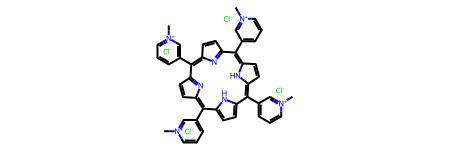

In [29]:
#visiualize a molecule randomly
random

In [30]:
top_10_research_subject = porph['Assay Description'].value_counts().head(10)
top_10_research_subject

Assay Description
Cytotoxicity against human HCT116 cell line                                                                                                                                                                                                        17
Phototoxicity against human A549 cells assessed as reduction in cell proliferation irradiated with 1 J/cm2 of 650 nanometer laser light preincubated for 24 hrs measured after 48 hrs by MTT assay                                                 11
Phototoxicity against human ECA109 cells assessed as decrease in cell viability after 24 hrs at 16 J/cm2 irradiation by MTT assay                                                                                                                   9
Photosensitizing activity against human HeLa cells assessed as reduction in cell viability pre-incubated for 24 hrs followed by 15 mins exposure to 670 to 710 nm light at dose of 2.0 J/cm2 and measured 12 hrs after radiation by WST-8 assay     

In [45]:

top_10_research_subject = porph['Assay Description'].value_counts().head(10)


def limit_words(description):
    return ' '.join(description.split()[:7])


top_10_table = pd.DataFrame({
    'Assay Description': top_10_research_subject.index,
    'Count': top_10_research_subject.values
})


top_10_table['Assay Description'] = top_10_table['Assay Description'].apply(limit_words)


print(top_10_table)

                                   Assay Description  Count
0        Cytotoxicity against human HCT116 cell line     17
1  Phototoxicity against human A549 cells assesse...     11
2  Phototoxicity against human ECA109 cells asses...      9
3  Photosensitizing activity against human HeLa c...      9
4  Cytotoxicity in rat R3230AC cells irradiated with      7
5         Dark toxicity in human A549 cells assessed      7
6           Dark toxicity in human HepG2 cells after      6
7  Phototoxicity against human HaCaT cells assess...      6
8  Cytotoxicity against human Bel7402 cells after 48      6
9  Antileishmanial activity against promastigote ...      6


In [46]:
top_3_values = porph['Standard Type'].value_counts().head(3)
top_3_values

Standard Type
IC50    317
Name: count, dtype: int64

# Frequency of assays

In [31]:
# Function of the most frequently worked structure
def freq(struc):
    col_list =  Counter(list(struc['Molecule ChEMBL ID']))
    res = dict(sorted(col_list.items(), key = itemgetter(1), reverse = True)[:7])
    return res
freq(porph)

{'CHEMBL65606': 7,
 'CHEMBL500576': 6,
 'CHEMBL1956500': 5,
 'CHEMBL1325592': 5,
 'CHEMBL2170855': 4,
 'CHEMBL207155': 3,
 'CHEMBL353314': 3}

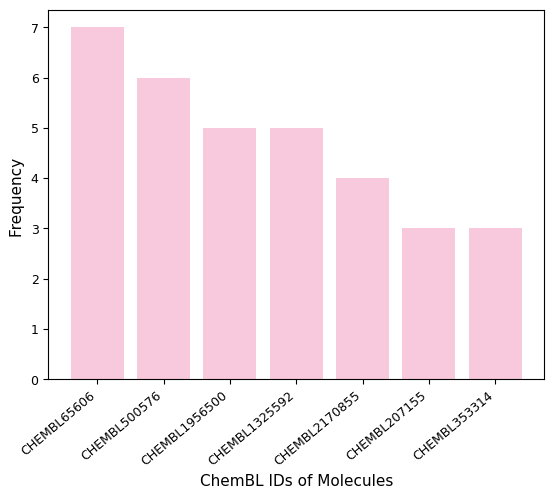

In [32]:
x=plt.bar(range(len(freq(porph))), list(freq(porph).values()), align='center',color ="#F8C8DC")
plt.xticks(range(len(freq(porph))), freq(porph).keys()) 
plt.xticks(rotation=40,fontsize='9',horizontalalignment='right')
plt.yticks(fontsize='9')
plt.xlabel('ChemBL IDs of Molecules',  color='black',
   fontsize='11', horizontalalignment='center')
plt.ylabel('Frequency ',  color='black',
   fontsize='11', horizontalalignment='center')
plt.grid(False);

In [33]:
freq_data = freq(porph)
keys = list(freq_data.keys())[:2]
smiles_list = list(porph.loc[porph['Molecule ChEMBL ID'].isin(keys), 'Smiles'])

# Molekülleri çizme
molecules = [Chem.MolFromSmiles(smiles) for smiles in smiles_list]
img = Draw.MolsToGridImage(molecules[0:2], molsPerRow=2, subImgSize=(200, 200))

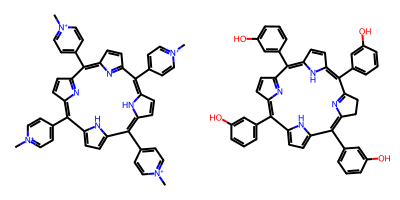

In [726]:
img

# Activity

In [ ]:
# IC50>10000 nM accepted as non-active

In [22]:
# assume Standard Value==0 as inactive
porph['Standard Value'] = porph['Standard Value'].fillna(10001)
porph=porph.dropna(subset=['Standard Value'])

In [23]:
# Labelling structures as active or non-active (Deep Learning Approach for Discovery of In Silico Drugs for Combating COVID-19)
rating = []
for row in porph["Standard Value"]:
    if row >= 10000 :    rating.append("pIC$_5$$_0$ inactive") 
    elif row < 10000:   rating.append("pIC$_5$$_0$ active")
    else:  rating.append("pIC$_5$$_0$ inactive")


In [24]:
# Assign active molecules
porph['activity_status'] = rating
porph[0:3]

,index,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,...,Document ChEMBL ID,Source ID,Source Description,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value,activity_status
0,16,CHEMBL268410,NaN,NaN,1279.63,NaN,NaN,7,CC1=C(C(COC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3...,IC50,...,CHEMBL1126254,1.00,Scientific Literature,J Med Chem,1992.00,NaN,NaN,NaN,NaN,pIC$_5$$_0$ active
1,39,CHEMBL4741802,NaN,NaN,813.95,3.00,7.97,3a,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O...,IC50,...,CHEMBL4706542,1.00,Scientific Literature,Eur J Med Chem,2020.00,CHEMBL3307651,TIME = 48.0 hr,NaN,NaN,pIC$_5$$_0$ inactive
2,40,CHEMBL2111186,TALAPORFIN,3.00,711.77,3.00,5.95,Talaporfin,C=Cc1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O)O)C(=O)...,IC50,...,CHEMBL4706542,1.00,Scientific Literature,Eur J Med Chem,2020.00,CHEMBL3307762,TIME = 48.0 hr,NaN,NaN,pIC$_5$$_0$ inactive


# pIC50 calculation of Compounds

In [123]:
result = []
for value in porph['Standard Value']:
    if value < 0:
        solution_log=0
    elif value==0 : 
        solution_log=0
    elif value=='': 
        solution_log=0
    else:
        solution_log=round(math.log(value*(10**-9),10)*-1,2)
    result.append(solution_log)   
    
porph["pIC$_5$$_0$"]= result
porph[0:3]


,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,Standard Relation,...,Document ChEMBL ID,Source ID,Source Description,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value,pIC$_5$$_0$
0,CHEMBL1325592,PROTOPORPHYRIN,-1.00,562.67,2.00,7.50,SID50106857,C=CC1=C(C)c2cc3[nH]c(cc4nc(cc5[nH]c(cc1n2)c(C)...,Potency,'=',...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.00
1,CHEMBL441738,AFAMELANOTIDE,4.00,1646.87,NaN,NaN,NDP-MSH,CCCC[C@H](NC(=O)[C@H](CO)NC(=O)[C@H](Cc1ccc(O)...,EC50,'=',...,CHEMBL1136069,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,CHEMBL3307715,NaN,NaN,NaN,7.92
2,CHEMBL441738,AFAMELANOTIDE,4.00,1646.87,NaN,NaN,NDP-MSH,CCCC[C@H](NC(=O)[C@H](CO)NC(=O)[C@H](Cc1ccc(O)...,EC50,'=',...,CHEMBL1136069,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,CHEMBL3307715,NaN,NaN,NaN,7.12


In [26]:
# pIC50 z-score calculation
porph['z_score'] = stats.zscore(porph['pIC$_5$$_0$'])
porph_cleaned = porph[(porph['z_score'] < 3) & (porph['z_score'] > -3)]
porph_cleaned.reset_index(drop=True, inplace=True)

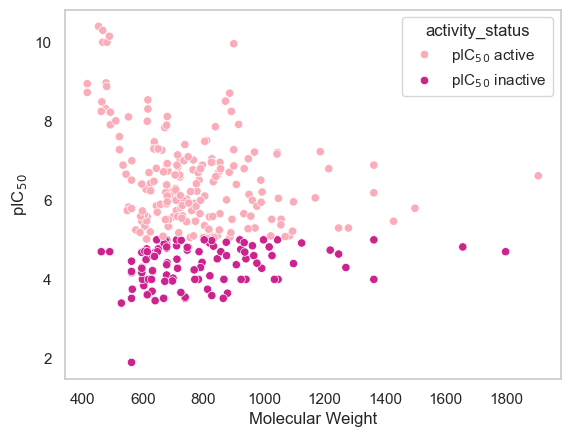

In [581]:
sns.scatterplot(x='Molecular Weight',y='pIC$_5$$_0$',hue='activity_status', data=porph,palette="RdPu")
sns.color_palette("mako", as_cmap=True)
plt.grid(False);

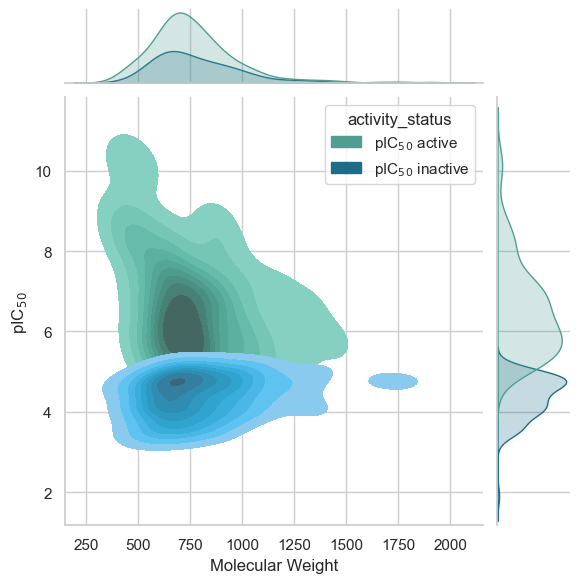

In [582]:
sns.jointplot(
    x='Molecular Weight', 
    y='pIC$_5$$_0$', 
    hue='activity_status', 
    data=porph, 
    palette="crest", 
    kind="kde", 
    fill=True
    
);

''

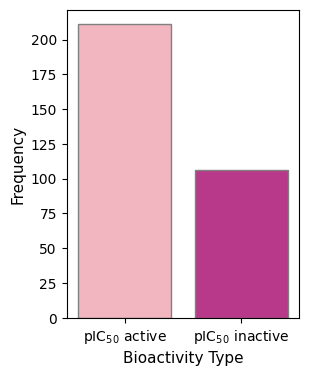

In [67]:
plt.figure(figsize=(3,4))
sns.countplot(x='activity_status', data=porph, palette="RdPu", edgecolor='grey')
plt.xlabel('Bioactivity Type', fontsize=11)
plt.ylabel('Frequency', fontsize=11)
plt.grid(False)
plt.savefig('ratio_active.png', dpi=600)
;

In [104]:
percentage = (porph['activity'] == "1").mean() * 100
print(f"Percentage of 'activity' == 1: {percentage:.2f}%")


Percentage of 'activity' == 1: 66.56%


In [105]:
count = porph['activity'].eq("1").sum()
print(f"Count of 'activity' == '1': {count}")

Count of 'activity' == '1': 211


In [487]:
percentage = (porph['activity_status'] == "pIC$_5$$_0$ active").mean() * 100
print(f"Percentage of 'activity' == 1: {percentage:.2f}%") 

Percentage of 'activity' == 1: 66.56%


In [492]:
percentage = (porph['activity_status'] == "pIC$_5$$_0$ inactive").mean() * 100
print(f"Percentage of 'activity' == 1: {percentage:.2f}%") 

Percentage of 'activity' == 1: 33.44%


In [495]:
count_ = porph['activity_status'].eq("pIC$_5$$_0$ inactive").sum()
print(f"Count of 'activity' == 'pIC$_5$$_0$ inactive': {count_}")

Count of 'activity' == 'pIC$_5$$_0$ inactive': 106


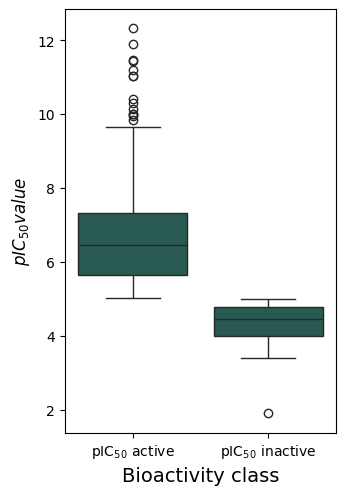

In [27]:
plt.figure(figsize=(3.5, 5.5))
sns.boxplot(x = 'activity_status', y = 'pIC$_5$$_0$', data = porph, color="#1f6357")
plt.xlabel('Bioactivity class', fontsize=14)
plt.ylabel("$pIC_{50} value$", fontsize=12, fontweight='bold');

# Lipinski Rule of Five

In [27]:
def calculate_ro5_properties(smiles):
    """
    Test if input molecule (SMILES) fulfills Lipinski's rule of five.

    Parameters
    ----------
    smiles : str
        SMILES for a molecule.

    Returns
    -------
    pandas.Series
        Molecular weight, number of hydrogen bond acceptors/donor and logP value
        and Lipinski's rule of five compliance for input molecule.
    """
    # RDKit molecule from SMILES
    molecule = Chem.MolFromSmiles(smiles)
    # Calculate Ro5-relevant chemical properties
    molecular_weight = Descriptors.ExactMolWt(molecule)
    n_hba = Descriptors.NumHAcceptors(molecule)
    n_hbd = Descriptors.NumHDonors(molecule)
    logp = Descriptors.MolLogP(molecule)
    # Check if Ro5 conditions fulfilled
    conditions = [molecular_weight <= 500, n_hba <= 10, n_hbd <= 5, logp <= 5]
    ro5_fulfilled = sum(conditions) >= 3
    # Return True if no more than one out of four conditions is violated
    return pd.Series(
        [molecular_weight, n_hba, n_hbd, logp, ro5_fulfilled],
        index=["molecular_weight", "n_hba", "n_hbd", "logp", "ro5_fulfilled"],
    )

In [28]:
porph=porph.dropna(subset=['Smiles'])

In [29]:
ro5_properties = porph["Smiles"].apply(calculate_ro5_properties)
ro5_properties.head()

,molecular_weight,n_hba,n_hbd,logp,ro5_fulfilled
0,1278.69,12,4,14.60,False
1,813.39,8,7,7.97,False
2,711.29,7,7,5.95,False
3,698.37,6,5,9.01,False
4,630.27,8,8,3.53,False


In [30]:
molecules = pd.concat([porph, ro5_properties], axis=1)
molecules.head()

,index,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,...,Action Type,Standard Text Value,activity_status,pIC$_5$$_0$,z_score,molecular_weight,n_hba,n_hbd,logp,ro5_fulfilled
0,16,CHEMBL268410,NaN,NaN,1279.63,NaN,NaN,7,CC1=C(C(COC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3...,IC50,...,NaN,NaN,pIC$_5$$_0$ active,5.30,-0.35,1278.69,12,4,14.60,False
1,39,CHEMBL4741802,NaN,NaN,813.95,3.00,7.97,3a,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O...,IC50,...,NaN,NaN,pIC$_5$$_0$ inactive,3.75,-1.45,813.39,8,7,7.97,False
2,40,CHEMBL2111186,TALAPORFIN,3.00,711.77,3.00,5.95,Talaporfin,C=Cc1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O)O)C(=O)...,IC50,...,NaN,NaN,pIC$_5$$_0$ inactive,4.85,-0.67,711.29,7,7,5.95,False
3,41,CHEMBL4744564,NaN,NaN,698.86,2.00,9.01,1,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)O)c4[nH]c(cc5...,IC50,...,NaN,NaN,pIC$_5$$_0$ active,5.58,-0.16,698.37,6,5,9.01,False
4,60,CHEMBL12659,NaN,NaN,630.70,2.00,3.53,12,CC1=C(C(O)CO)c2cc3nc(cc4[nH]c(cc5[nH]c(cc1n2)c...,IC50,...,NaN,NaN,pIC$_5$$_0$ inactive,3.70,-1.48,630.27,8,8,3.53,False


In [31]:
# Note that the column "ro5_fulfilled" contains boolean values.
# Thus, we can use the column values directly to subset data.
# Note that ~ negates boolean values.
molecules_ro5_fulfilled = molecules[molecules["ro5_fulfilled"]]
molecules_ro5_violated = molecules[~molecules["ro5_fulfilled"]]

print(f"# compounds in unfiltered data set: {molecules.shape[0]}")
print(f"# compounds in filtered data set: {molecules_ro5_fulfilled.shape[0]}")
print(f"# compounds not compliant with the Ro5: {molecules_ro5_violated.shape[0]}")
# NBVAL_CHECK_OUTPUT


# compounds in unfiltered data set: 317
# compounds in filtered data set: 46
# compounds not compliant with the Ro5: 271


In [32]:
molecules_ro5_fulfilled.head()

,index,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,...,Action Type,Standard Text Value,activity_status,pIC$_5$$_0$,z_score,molecular_weight,n_hba,n_hbd,logp,ro5_fulfilled
11,263,CHEMBL337559,TMPYP4 CHLORIDE,NaN,820.66,2.00,6.62,TMPyP4 2H,C[n+]1ccc(-c2c3nc(c(-c4cc[n+](C)cc4)c4ccc([nH]...,IC50,...,NaN,NaN,pIC$_5$$_0$ active,5.20,-0.42,818.20,2,2,-5.36,True
12,288,CHEMBL344150,NaN,NaN,820.66,2.00,6.62,TMPyP3,C[n+]1cccc(-c2c3nc(c(-c4ccc[n+](C)c4)c4ccc([nH...,IC50,...,NaN,NaN,pIC$_5$$_0$ inactive,4.92,-0.62,818.20,2,2,-5.36,True
27,579,CHEMBL1933798,NaN,NaN,1057.10,2.00,7.86,3,CN(C)/C=C/C(=C\C=[N+](C)C)c1c2nc(c(C(/C=C/N(C)...,IC50,...,NaN,NaN,pIC$_5$$_0$ active,5.52,-0.20,1054.49,6,2,-4.12,True
33,623,CHEMBL210258,NaN,NaN,478.56,1.00,7.70,19,Oc1cccc(-c2c3nc(cc4ccc([nH]4)c(-c4ccccc4)c4nc(...,IC50,...,NaN,NaN,pIC$_5$$_0$ active,8.97,2.23,478.18,3,3,7.70,True
39,788,CHEMBL2420128,NaN,NaN,490.57,1.00,7.80,4b,O=Cc1c2nc(c(-c3ccccc3)c3ccc(cc4nc(c(-c5ccccc5)...,IC50,...,NaN,NaN,pIC$_5$$_0$ inactive,4.70,-0.78,490.18,3,2,7.80,True


In [33]:

def calculate_mean_std(dataframe):
    """
    Calculate the mean and standard deviation of a dataset.

    Parameters
    ----------
    dataframe : pd.DataFrame
        Properties (columns) for a set of items (rows).

    Returns
    -------
    pd.DataFrame
        Mean and standard deviation (columns) for different properties (rows).
    """
    # Generate descriptive statistics for property columns
    stats = dataframe.describe()
    # Transpose DataFrame (statistical measures = columns)
    stats = stats.T
    # Select mean and standard deviation
    stats = stats[["mean", "std"]]
    return stats

In [34]:
molecules_ro5_fulfilled_stats = calculate_mean_std(
    molecules_ro5_fulfilled[["molecular_weight", "n_hba", "n_hbd", "logp"]]
)
molecules_ro5_fulfilled_stats
# NBVAL_CHECK_OUTPUT


,mean,std
molecular_weight,733.34,255.22
n_hba,3.76,1.83
n_hbd,2.22,0.81
logp,2.74,4.01


In [35]:
molecules_ro5_violated_stats = calculate_mean_std(
    molecules_ro5_violated[["molecular_weight", "n_hba", "n_hbd", "logp"]]
)
molecules_ro5_violated_stats


,mean,std
molecular_weight,780.40,204.39
n_hba,7.05,3.43
n_hbd,3.99,2.11
logp,8.65,2.99


In [36]:
def _scale_by_thresholds(stats, thresholds, scaled_threshold):
    """
    Scale values for different properties that have each an individually defined threshold.

    Parameters
    ----------
    stats : pd.DataFrame
        Dataframe with "mean" and "std" (columns) for each physicochemical property (rows).
    thresholds : dict of str: int
        Thresholds defined for each property.
    scaled_threshold : int or float
        Scaled thresholds across all properties.

    Returns
    -------
    pd.DataFrame
        DataFrame with scaled means and standard deviations for each physiochemical property.
    """
    # Raise error if scaling keys and data_stats indicies are not matching
    for property_name in stats.index:
        if property_name not in thresholds.keys():
            raise KeyError(f"Add property '{property_name}' to scaling variable.")
    # Scale property data
    stats_scaled = stats.apply(lambda x: x / thresholds[x.name] * scaled_threshold, axis=1)
    return stats_scaled

In [37]:
def _define_radial_axes_angles(n_axes):
    """Define angles (radians) for radial (x-)axes depending on the number of axes."""
    x_angles = [i / float(n_axes) * 2 * math.pi for i in range(n_axes)]
    x_angles += x_angles[:1]
    return x_angles


In [38]:
def plot_radar(
    y,
    thresholds,
    scaled_threshold,
    properties_labels,
    y_max=None,
    output_path=None,
):
    """
    Plot a radar chart based on the mean and standard deviation of a data set's properties.

    Parameters
    ----------
    y : pd.DataFrame
        Dataframe with "mean" and "std" (columns) for each physicochemical property (rows).
    thresholds : dict of str: int
        Thresholds defined for each property.
    scaled_threshold : int or float
        Scaled thresholds across all properties.
    properties_labels : list of str
        List of property names to be used as labels in the plot.
    y_max : None or int or float
        Set maximum y value. If None, let matplotlib decide.
    output_path : None or pathlib.Path
        If not None, save plot to file.
    """

    # Define radial x-axes angles -- uses our helper function!
    x = _define_radial_axes_angles(len(y))
    # Scale y-axis values with respect to a defined threshold -- uses our helper function!
    y = _scale_by_thresholds(y, thresholds, scaled_threshold)
    # Since our chart will be circular we append the first value of each property to the end
    y = pd.concat([y, y.head(1)])

    # Set figure and subplot axis
    plt.figure(figsize=(3, 3))
    
    ax = plt.subplot(111, polar=True)

    # Plot data
    ax.fill(x, [scaled_threshold] * len(x),"#DC143C", alpha=0.2)
    ax.plot(x, y["mean"], "#F89880", lw=3, ls="-")
    ax.plot(x, y["mean"] + y["std"], "#E30B5C", lw=2, ls="--")
    ax.plot(x, y["mean"] - y["std"], "#FF10F0", lw=2, ls="-.")

    # From here on, we only do plot cosmetics
    # Set 0° to 12 o'clock
    ax.set_theta_offset(math.pi / 2)
    # Set clockwise rotation
    ax.set_theta_direction(-1)

    # Set y-labels next to 180° radius axis
    ax.set_rlabel_position(180)
    # Set number of radial axes' ticks and remove labels
    plt.xticks(x, [])
    # Get maximal y-ticks value
    if not y_max:
        y_max = int(ax.get_yticks()[-1])
    # Set axes limits
    plt.ylim(0, y_max)
    # Set number and labels of y axis ticks
    plt.yticks(
        range(1, y_max),
        ["5" if i == scaled_threshold else "" for i in range(1, y_max)],
        fontsize=16,
    )

    # Draw ytick labels to make sure they fit properly
    # Note that we use [:1] to exclude the last element which equals the first element (not needed here)
    for i, (angle, label) in enumerate(zip(x[:-1], properties_labels)):
        if angle == 0:
            ha = "center"
        elif 0 < angle < math.pi:
            ha = "left"
        elif angle == math.pi:
            ha = "center"
        else:
            ha = "right"
        ax.text(
            x=angle,
            y=y_max + 1,
            s=label,
            size=16,
            horizontalalignment=ha,
            verticalalignment="center",
        )

    # Add legend relative to top-left plot
    labels = ("mean", "mean + std", "mean - std", "rule of five area")
    ax.legend(labels, loc=(1.1, 0.7), labelspacing=0.3, fontsize=16)

    # Save plot - use bbox_inches to include text boxes
    if output_path:
        plt.savefig(output_path, dpi=300, bbox_inches="tight", transparent=True)

    plt.show()

In [39]:
thresholds = {"molecular_weight": 650, "n_hba": 4, "n_hbd": 2, "logp": 5}
scaled_threshold = 5
properties_labels = [
    "Molecular weight (Da) / 100",
    "# HBA / 2",
    "# HBD",
    "LogP",
]
y_max = 8

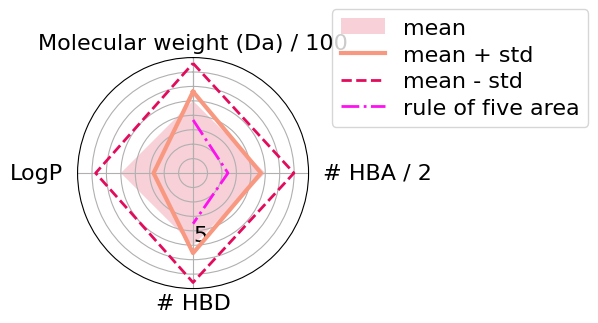

In [40]:
plot_radar(
    molecules_ro5_fulfilled_stats,
    thresholds,
    scaled_threshold,
    properties_labels,
    y_max,
)

plt.show()

In [41]:
thresholds = {"molecular_weight": 730, "n_hba": 8, "n_hbd": 4, "logp": 8}
scaled_threshold = 5
properties_labels = [
    "Molecular weight (Da) / 100",
    "# HBA / 2",
    "# HBD",
    "LogP",
]
y_max = 8

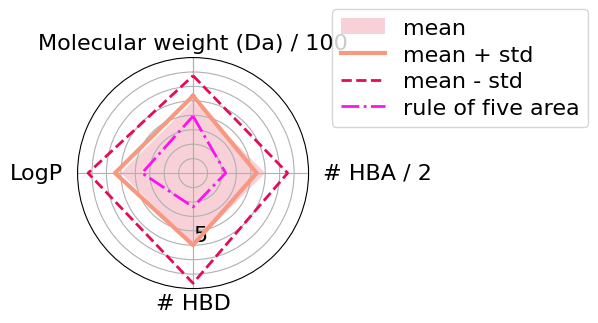

In [93]:

plot_radar(
    molecules_ro5_violated_stats,
    thresholds,
    scaled_threshold,
    properties_labels,
    y_max,
)


plt.show()


In [46]:
a=porph[porph.activity_status == "pIC$_5$$_0$ active"]
list1=a['Smiles'].tolist()
list2= molecules_ro5_fulfilled['Smiles'].tolist()


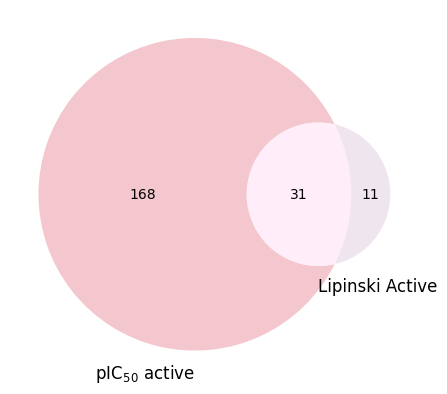

In [47]:

A=set(list1)
B=set(list2)
diagram = venn2([A, B],("pIC$_5$$_0$ active","Lipinski Active"),set_colors=("#E37383", "#D8BFD8"))

plt.savefig('lipinski_venn.png', dpi=600)
plt.show()

In [43]:
#Jak2 inhibitor – a jackpot for pharmaceutical industries: a comprehensive computational method in the discovery of new potent Jak2 inhibitorsi
list_inactive=[]
for i in porph['activity_status']:
    if i=='pIC$_5$$_0$ inactive':
        list_inactive.append("0")
    else: list_inactive.append("1")
porph['activity']= list_inactive

In [48]:
# Extract intersect dataframe for further analysis
intersect=A.intersection(B)
intersect_cox=porph.loc[porph['Smiles'].isin(intersect)] # there are 296>267 molecules which means there are replicates
intersect_cox [0:3]

,index,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,...,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value,activity_status,pIC$_5$$_0$,z_score,activity
11,263,CHEMBL337559,TMPYP4 CHLORIDE,NaN,820.66,2.00,6.62,TMPyP4 2H,C[n+]1ccc(-c2c3nc(c(-c4cc[n+](C)cc4)c4ccc([nH]...,IC50,...,J Med Chem,2001.00,NaN,NaN,NaN,NaN,pIC$_5$$_0$ active,5.20,-0.42,1
27,579,CHEMBL1933798,NaN,NaN,1057.10,2.00,7.86,3,CN(C)/C=C/C(=C\C=[N+](C)C)c1c2nc(c(C(/C=C/N(C)...,IC50,...,Bioorg Med Chem Lett,2012.00,CHEMBL3307654,NaN,NaN,NaN,pIC$_5$$_0$ active,5.52,-0.20,1
33,623,CHEMBL210258,NaN,NaN,478.56,1.00,7.70,19,Oc1cccc(-c2c3nc(cc4ccc([nH]4)c(-c4ccccc4)c4nc(...,IC50,...,J Med Chem,2006.00,CHEMBL3308372,NaN,NaN,NaN,pIC$_5$$_0$ active,8.97,2.23,1


In [49]:
from rdkit.ML.Descriptors import MoleculeDescriptors
def RDkit_descriptors(smiles):
    mols = [Chem.MolFromSmiles(i) for i in smiles] 
    calc = MoleculeDescriptors.MolecularDescriptorCalculator([x[0] for x in Descriptors._descList])
    desc_names = calc.GetDescriptorNames()
    
    Mol_descriptors =[]
    for mol in mols:
        # add hydrogens to molecules
        mol=Chem.AddHs(mol)
        # Calculate all 200 descriptors for each molecule
        descriptors = calc.CalcDescriptors(mol)
        Mol_descriptors.append(descriptors)
    return Mol_descriptors,desc_names 

# Function call
Mol_descriptors,desc_names = RDkit_descriptors(porph['Smiles'])

In [51]:
df_with_200_descriptors = pd.DataFrame(Mol_descriptors,columns=desc_names)
df_with_200_descriptors.head()

,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,HeavyAtomMolWt,ExactMolWt,NumValenceElectrons,...,fr_sulfide,fr_sulfonamd,fr_sulfone,fr_term_acetylene,fr_tetrazole,fr_thiazole,fr_thiocyan,fr_thiophene,fr_unbrch_alkane,fr_urea
0,17.80,17.80,1.37,-7.14,0.07,75.28,1279.63,1184.87,1278.69,498,...,0,0,0,0,0,0,0,0,0,0
1,15.57,15.57,1.15,-5.88,0.06,37.05,813.95,758.51,813.39,316,...,0,0,0,0,0,0,0,0,0,0
2,15.31,15.31,0.65,-5.55,0.12,33.12,711.77,670.44,711.29,272,...,0,0,0,0,0,0,0,0,0,0
3,14.34,14.34,0.92,-5.51,0.10,38.35,698.86,648.46,698.37,272,...,0,0,0,0,0,0,0,0,0,0
4,13.06,13.06,0.67,-4.68,0.16,30.70,630.70,592.39,630.27,242,...,0,0,0,0,0,0,0,0,0,0


In [52]:
df_with_200_descriptors['pIC$_5$$_0$'] = porph['pIC$_5$$_0$']

In [53]:
porph.corr(numeric_only=True) 

,index,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Standard Value,pChEMBL Value,Ligand Efficiency BEI,Ligand Efficiency LE,Ligand Efficiency LLE,Ligand Efficiency SEI,Potential Duplicate,Source ID,Document Year,pIC$_5$$_0$,z_score
index,1.00,-0.70,-0.16,-0.06,-0.08,0.06,0.15,0.35,0.66,0.21,0.26,NaN,0.13,0.22,0.15,0.15
Molecule Max Phase,-0.70,1.00,0.57,0.69,-0.08,-0.42,0.12,NaN,NaN,NaN,NaN,NaN,-0.47,0.49,0.45,0.45
Molecular Weight,-0.16,0.57,1.00,0.37,0.29,-0.06,-0.28,-0.64,-0.44,-0.28,0.30,NaN,-0.06,-0.20,-0.19,-0.19
#RO5 Violations,-0.06,0.69,0.37,1.00,0.17,-0.00,-0.43,0.02,-0.07,-0.13,-0.19,NaN,0.09,0.03,-0.38,-0.38
AlogP,-0.08,-0.08,0.29,0.17,1.00,-0.03,-0.09,-0.44,-0.37,-0.95,-0.08,NaN,-0.05,-0.12,-0.01,-0.01
Standard Value,0.06,-0.42,-0.06,-0.00,-0.03,1.00,-0.59,-0.16,-0.19,0.22,-0.27,NaN,-0.01,0.03,-0.20,-0.20
pChEMBL Value,0.15,0.12,-0.28,-0.43,-0.09,-0.59,1.00,0.31,0.39,-0.10,0.17,NaN,-0.03,0.07,1.00,1.00
Ligand Efficiency BEI,0.35,NaN,-0.64,0.02,-0.44,-0.16,0.31,1.00,0.95,0.60,0.36,NaN,NaN,0.33,0.31,0.31
Ligand Efficiency LE,0.66,NaN,-0.44,-0.07,-0.37,-0.19,0.39,0.95,1.00,0.54,0.27,NaN,NaN,0.31,0.39,0.39
Ligand Efficiency LLE,0.21,NaN,-0.28,-0.13,-0.95,0.22,-0.10,0.60,0.54,1.00,0.14,NaN,NaN,-0.12,-0.10,-0.10


In [54]:
df_cleaned = df_with_200_descriptors.dropna()

In [55]:
# Correlation matrix
plt.figure(figsize=(105,105))
sns.heatmap(df_cleaned.corr(numeric_only=True),annot=True)
plt.xticks(rotation=60) 
# Save the figure
plt.savefig('correlation_matrix_porph.png', bbox_inches='tight', dpi=300)
plt.show()

In [56]:
a = abs(df_cleaned.corr(numeric_only=True)).loc['pIC$_5$$_0$'].sort_values(ascending=False)
a=a.drop('pIC$_5$$_0$')
a

qed                0.34
fr_Al_COO          0.30
EState_VSA10       0.28
fr_COO2            0.28
fr_COO             0.28
                   ... 
fr_tetrazole        NaN
fr_thiazole         NaN
fr_thiocyan         NaN
fr_unbrch_alkane    NaN
fr_urea             NaN
Name: pIC$_5$$_0$, Length: 210, dtype: float64

In [57]:
# parameters >.25 
selected_features = a[a >= 0.25].index
selected_features

Index(['qed', 'fr_Al_COO', 'EState_VSA10', 'fr_COO2', 'fr_COO', 'SMR_VSA10',
       'TPSA', 'VSA_EState4', 'NOCount', 'NHOHCount', 'HallKierAlpha',
       'NumHDonors'],
      dtype='object')

In [131]:
# parameters >0.1 
selected_features2 = a[a >= 0.1].index
selected_features2

Index(['qed', 'fr_Al_COO', 'EState_VSA10', 'fr_COO2', 'fr_COO', 'SMR_VSA10',
       'TPSA', 'VSA_EState4', 'NOCount', 'NHOHCount', 'HallKierAlpha',
       'NumHDonors', 'NumValenceElectrons', 'HeavyAtomCount', 'VSA_EState2',
       'MolMR', 'Chi1', 'fr_C_O', 'SlogP_VSA7', 'Kappa2', 'Chi2n', 'Chi3n',
       'Chi0', 'EState_VSA1', 'PEOE_VSA14', 'LabuteASA', 'fr_sulfonamd',
       'BertzCT', 'fr_NH1', 'NumHeteroatoms', 'NumHAcceptors', 'Chi0n',
       'Chi1n', 'Chi4n', 'Chi1v', 'Chi0v', 'fr_Nhpyrrole', 'fr_Ar_NH', 'Chi3v',
       'Kappa3', 'Chi2v', 'Kappa1', 'MolWt', 'ExactMolWt', 'Chi4v',
       'HeavyAtomMolWt', 'MaxEStateIndex', 'MaxAbsEStateIndex', 'SlogP_VSA2',
       'fr_allylic_oxid', 'PEOE_VSA7', 'VSA_EState1', 'PEOE_VSA8',
       'NumRotatableBonds', 'fr_Ndealkylation2', 'SlogP_VSA3', 'VSA_EState10',
       'fr_ketone_Topliss', 'fr_ketone', 'SMR_VSA1', 'BCUT2D_MWHI', 'SMR_VSA3',
       'SMR_VSA2', 'fr_amide', 'PEOE_VSA2', 'EState_VSA3', 'fr_aniline',
       'fr_aryl_methyl', 'ESt

In [132]:
df_selected2 = df_with_200_descriptors[selected_features2]

In [133]:
df_selected2['pIC$_5$$_0$'] = porph['pIC$_5$$_0$']

In [134]:
# Correlation matrix
plt.figure(figsize=(105,105))
sns.heatmap(df_selected2.corr(numeric_only=True),annot=True)
plt.xticks(rotation=60) 
# Save the figure
plt.savefig('correlation_matrix_porph2.png', bbox_inches='tight', dpi=300)
plt.show()

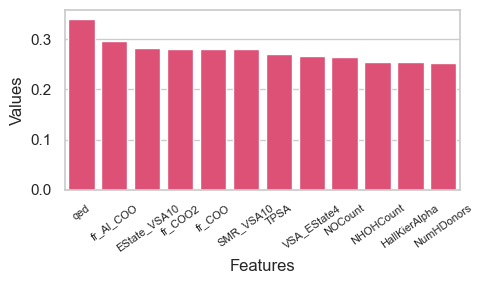

In [584]:
feature_counts = a[selected_features]
features_list = selected_features.tolist()
# Çubuk grafiği oluşturma
plt.figure(figsize=(5, 3))
sns.barplot(x=features_list, y=feature_counts[features_list], color="#F33A6A")

plt.xlabel('Features')
plt.ylabel('Values')
plt.xticks(rotation=35)
plt.xticks(fontsize=8)
plt.tight_layout()

plt.savefig('Selected.png', dpi=600)
plt.show()

In [58]:
df_selected = df_with_200_descriptors[selected_features]

In [59]:
df_selected.isna().sum()

qed              0
fr_Al_COO        0
EState_VSA10     0
fr_COO2          0
fr_COO           0
SMR_VSA10        0
TPSA             0
VSA_EState4      0
NOCount          0
NHOHCount        0
HallKierAlpha    0
NumHDonors       0
dtype: int64

In [60]:
# quantitative estimation of drug-likeness (qed)
porph['qed'] = df_selected['qed'].values
porph['fr_Al_COO'] = df_selected['fr_Al_COO'].values

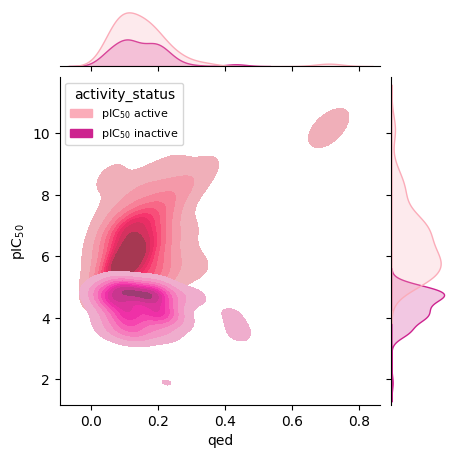

In [61]:
# Jointplot
g = sns.jointplot(
    x='qed', 
    y='pIC$_5$$_0$', 
    hue='activity_status', 
    data=porph, 
    palette="RdPu", 
    kind="kde", 
    fill=True
)
sns.move_legend(g.ax_joint, loc='upper left', fontsize=8)
# Boyut ayarla
g.fig.set_size_inches(4.5,4.5)
# Remove grid lines
g.ax_joint.grid(False)  # Main plot
g.ax_marg_x.grid(False)  # Marginal plot for x-axis
g.ax_marg_y.grid(False)  # Marginal plot for y-axis

plt.savefig('activity.png', dpi=600)
# Göster
plt.show()


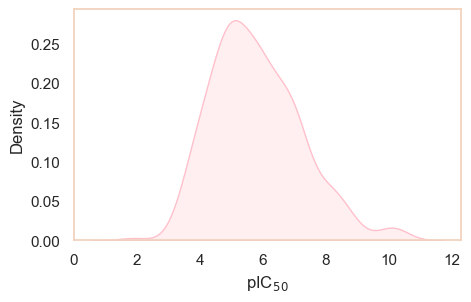

In [590]:
plt.figure(figsize=(5, 3))
sns.kdeplot(porph['pIC$_5$$_0$'],  fill=True,color="#FFC0CB")
# Set spine thickness

ax = plt.gca()  
ax.spines['top'].set_color('#F2D2BD')
ax.spines['right'].set_color('#F2D2BD')
ax.spines['left'].set_color('#F2D2BD')
ax.spines['bottom'].set_color('#F2D2BD')


plt.grid(False)
plt.savefig('distrubution.png', dpi=600)
plt.show()

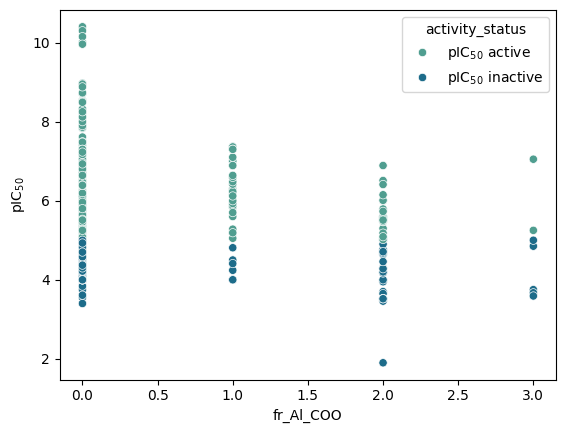

In [637]:
sns.scatterplot(x='fr_Al_COO',y='pIC$_5$$_0$',hue='activity_status', data=porph,palette="crest")
sns.color_palette("mako", as_cmap=True);

# TSNE

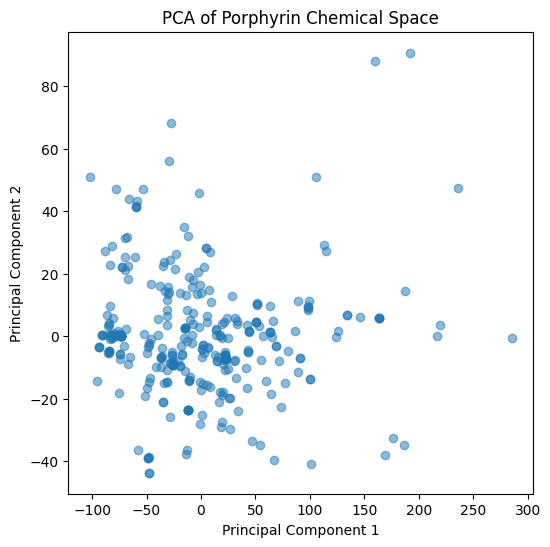

In [62]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt


pca = PCA(n_components=2)
principal_components = pca.fit_transform(df_selected )

plt.figure(figsize=(6, 6))
plt.scatter(principal_components[:, 0], principal_components[:, 1], alpha=0.5)
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Porphyrin Chemical Space')
plt.grid(False)
plt.savefig('pca_porphyrin.png', dpi=600)
plt.show()

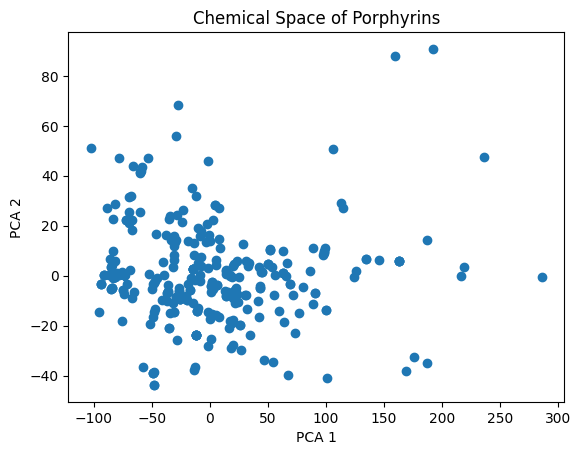

In [63]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# Apply PCA for dimensionality reduction
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_selected)

# Visualize
plt.scatter(pca_result[:, 0], pca_result[:, 1])
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')
plt.title('Chemical Space of Porphyrins')
plt.show()


In [64]:
#https://github.com/PatWalters/workshop/blob/master/predictive_models/2_visualizing_chemical_space.ipynb
def fp_list_from_smiles_list(smiles_list,nbits=2048):
    fp_list = []
    for smiles in tqdm(smiles_list):
        mol = Chem.MolFromSmiles(smiles)
        fp_list.append(fp_as_array(mol,nbits))
    return fp_list

def fp_as_array(mol,n_bits=2048):
    fp = AllChem.GetMorganFingerprintAsBitVect(mol, 2, nBits=n_bits)
    arr = np.zeros((1,), numpy.int_)
    DataStructs.ConvertToNumpyArray(fp, arr)
    return arr

In [65]:
fp_list = fp_list_from_smiles_list(porph["Smiles"]) # Get fingerprints for PCA analysis for porphyrin database !

  0%|          | 0/317 [00:00<?, ?it/s][00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPRECATION WARNING: please use MorganGenerator
[00:31:16] DEPREC

In [66]:
#Perform principal component analysis (PCA) on the fingerprints.
pca = PCA(n_components=2)
crds = pca.fit_transform(fp_list) 

In [67]:
crds_df = pd.DataFrame(crds,columns=["PC_1","PC_2"])
crds_df['is_active'] = list(porph['activity'])  
crds_df.head()

,PC_1,PC_2,is_active
0,0.91,2.55,1
1,4.30,1.71,0
2,4.57,-1.05,0
3,4.18,1.80,1
4,0.77,2.05,0


In [68]:
var = np.sum(pca.explained_variance_ratio_)
var

np.float64(0.3279951006917782)

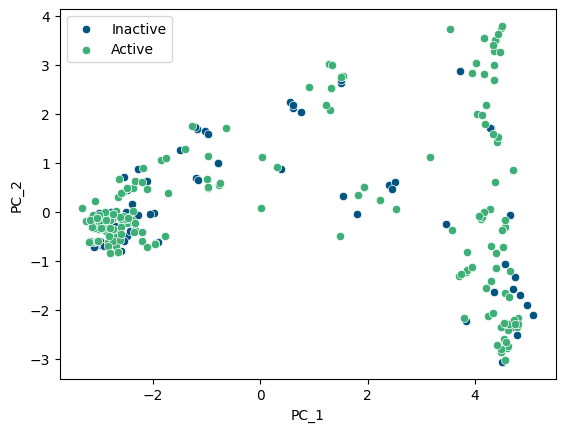

In [69]:
ax = sns.scatterplot(data=crds_df.query("is_active == '0'"),x="PC_1",y="PC_2",color='#015482')
ax = sns.scatterplot(data=crds_df.query("is_active == '1'"),x="PC_1",y="PC_2",color='#3eaf76')
b= plt.legend(labels=['Inactive', 'Active'])

# Similarity Search for dataframe


In [70]:
# Mol objects of structures for similarity search
list_mol=[]
for i in porph['Smiles']:
    mol = Chem.MolFromSmiles(i)
    list_mol.append(mol)
porph['mol']= list_mol
porph[0:3]

,index,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,...,Properties,Action Type,Standard Text Value,activity_status,pIC$_5$$_0$,z_score,activity,qed,fr_Al_COO,mol
0,16,CHEMBL268410,NaN,NaN,1279.63,NaN,NaN,7,CC1=C(C(COC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3...,IC50,...,NaN,NaN,NaN,pIC$_5$$_0$ active,5.30,-0.35,1,0.07,2,<rdkit.Chem.rdchem.Mol object at 0x000001BD23A...
1,39,CHEMBL4741802,NaN,NaN,813.95,3.00,7.97,3a,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O...,IC50,...,TIME = 48.0 hr,NaN,NaN,pIC$_5$$_0$ inactive,3.75,-1.45,0,0.06,3,<rdkit.Chem.rdchem.Mol object at 0x000001BD23A...
2,40,CHEMBL2111186,TALAPORFIN,3.00,711.77,3.00,5.95,Talaporfin,C=Cc1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O)O)C(=O)...,IC50,...,TIME = 48.0 hr,NaN,NaN,pIC$_5$$_0$ inactive,4.85,-0.67,0,0.12,3,<rdkit.Chem.rdchem.Mol object at 0x000001BD23A...


In [71]:
fps= [FingerprintMols.FingerprintMol(mol) for mol in list_mol]
fps[0:3]

In [72]:
list_9=porph["Molecule ChEMBL ID"].tolist()
list_9[0:3]

['CHEMBL268410', 'CHEMBL4741802', 'CHEMBL2111186']

In [73]:
inchis = []
for n in range(len(list_mol)):
    list_mol[n].SetProp('_Name', list_9[n]) # set a title line

In [74]:
size=len(list_mol)
hmap=np.empty(shape=(size,size))
table=pd.DataFrame()
for index, i in enumerate(fps):
     for jndex, j in enumerate(fps):
        similarity=DataStructs.FingerprintSimilarity(i,j)
        hmap[index,jndex]=similarity
        table.loc[list_mol[index].GetProp('_Name'),list_mol[jndex].GetProp('_Name')]=similarity


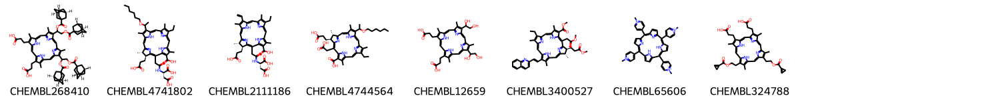

In [75]:
Draw.MolsToGridImage(list_mol[0:8],molsPerRow=10,subImgSize=(150,150), legends=[y for y in list_9])


# HCL clustering

In [76]:
#intersect data
linked = linkage(hmap,'single')
labelList = [mol.GetProp('_Name') for mol in list_mol]

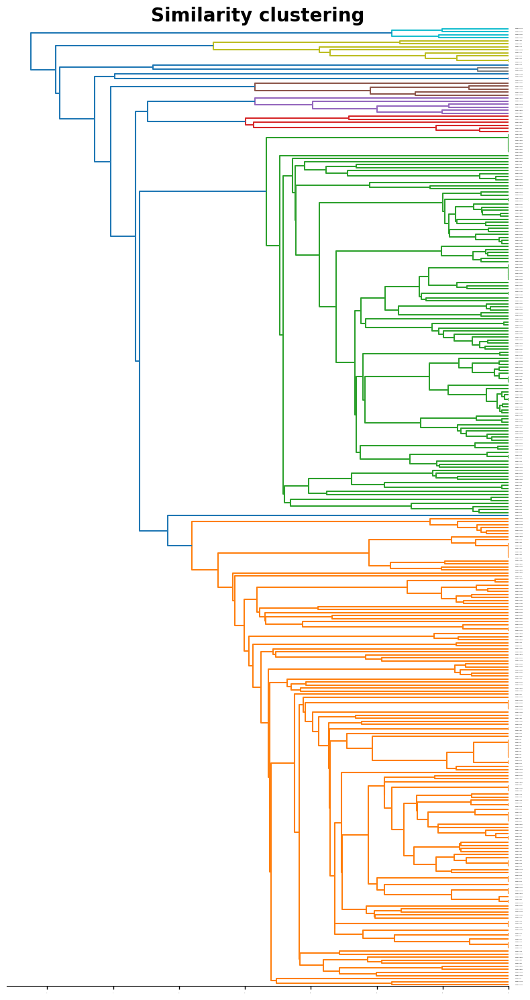

In [77]:
plt.figure(figsize=(8,15))

ax1=plt.subplot()
o=dendrogram(linked,  
            orientation='left',
            labels=labelList,
            distance_sort='descending',
            show_leaf_counts=True)

ax1.spines['left'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)
plt.title('Similarity clustering',fontsize=20,weight='bold')
plt.tick_params ('both',width=1,labelsize=0.1)
plt.tight_layout()
plt.grid(False)
plt.show() 

In [147]:
# Extract cluster colors assigned in the dendrogram
# C0: blue, C1:Orange, C2:Green , C3:Red, C4:Purple, C5:,C6: ,C7:, C8:
# Display the clusters grouped by color along with the count of molecules in each cluster
for color, molecules in color_dict.items():
    num_molecules = len(molecules)  # Count the number of molecules in the cluster
    print(f"\033[1mCluster Color: {color}\033[0m")  # Bold text
    print(f"  Number of Molecules: {num_molecules}")
    print(f"  Molecules: {', '.join(molecules)}\n")

Cluster Color: C1
  Number of Molecules: 155
  Molecules: CHEMBL2420129, CHEMBL2420128, CHEMBL84664, CHEMBL1204020, CHEMBL1204019, CHEMBL2448393, CHEMBL2448394, CHEMBL335814, CHEMBL343554, CHEMBL2448395, CHEMBL1202375, CHEMBL216608, CHEMBL353314, CHEMBL353314, CHEMBL353314, CHEMBL438407, CHEMBL64170, CHEMBL385213, CHEMBL2326209, CHEMBL345046, CHEMBL345046, CHEMBL345046, CHEMBL385913, CHEMBL1213288, CHEMBL2171698, CHEMBL4099866, CHEMBL2171697, CHEMBL2403179, CHEMBL337559, CHEMBL2448392, CHEMBL3885145, CHEMBL3883779, CHEMBL3884511, CHEMBL4084530, CHEMBL207155, CHEMBL207155, CHEMBL207155, CHEMBL448043, CHEMBL5191770, CHEMBL379212, CHEMBL208356, CHEMBL210824, CHEMBL210423, CHEMBL507897, CHEMBL453430, CHEMBL452165, CHEMBL500801, CHEMBL511020, CHEMBL504951, CHEMBL478547, CHEMBL502433, CHEMBL503674, CHEMBL4461583, CHEMBL4588761, CHEMBL377997, CHEMBL210507, CHEMBL210267, CHEMBL210267, CHEMBL380150, CHEMBL507368, CHEMBL376934, CHEMBL210258, CHEMBL210438, CHEMBL209298, CHEMBL379609, CHEMBL242013

In [144]:
# Select one molecule from each cluster color
selected_molecules = {color: molecules[0] for color, molecules in color_dict.items()}

# Draw molecules for each cluster color
mols = []
titles = []
for color, mol_name in selected_molecules.items():
    mol = next((m for m in list_mol if m.GetProp('_Name') == mol_name), None)
    if mol:
        mols.append(mol)
        titles.append(f"{mol_name} ({color})")

# Display the selected molecules
img = Draw.MolsToGridImage(mols, molsPerRow=4, subImgSize=(200, 200), legends=titles) 


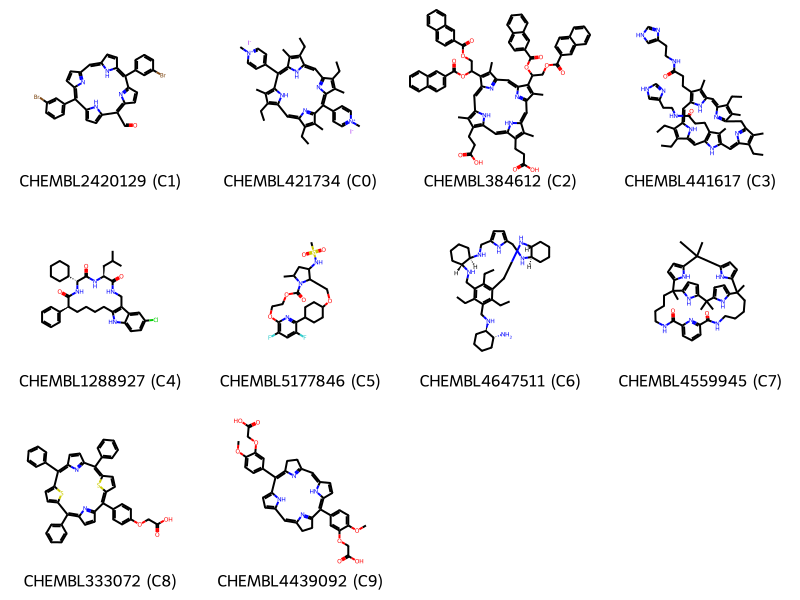

In [145]:
img

In [136]:
# Select five molecules from first two clusters

# Select 5 molecules from C1 and C2 clusters
selected_molecules = {
    "C1": color_dict.get("C1", [])[:5],  # Select first 5 molecules from C1
    "C2": color_dict.get("C2", [])[:5] ,  # Select first 5 molecules from C2
    "C3": color_dict.get("C3", [])[:5]   # Select first 5 molecules from C2
}

# Get molecule objects for selected SMILES
mols = []
titles = []
for color, mol_names in selected_molecules.items():
    for mol_name in mol_names:
        mol = next((m for m in list_mol if m.GetProp('_Name') == mol_name), None)
        if mol:
            mols.append(mol)
            titles.append(f"{mol_name} ({color})")

# Display the selected molecules
img2 = Draw.MolsToGridImage(mols, molsPerRow=5, subImgSize=(200, 200), legends=titles)



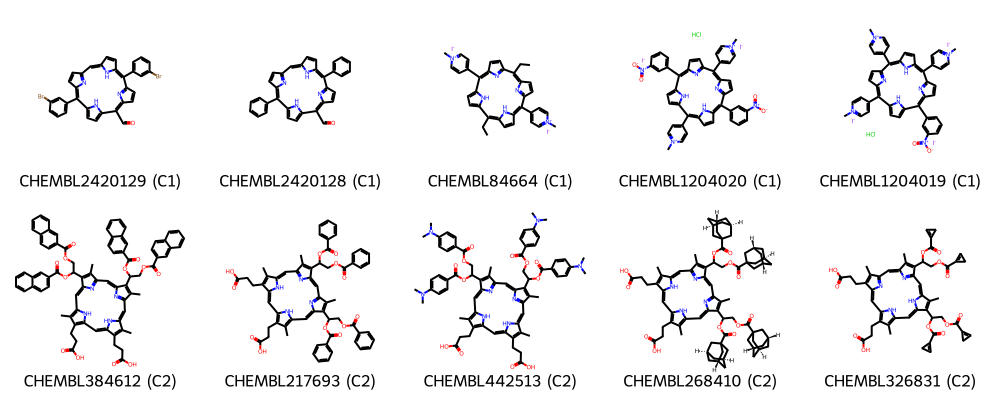

In [82]:
img2

In [83]:
# This will give us the clusters in order as the last plot
new_data=list(reversed(o['ivl']))

# we create a new table with the order of HCL
hmap_2=np.empty(shape=(size,size))
for index,i in enumerate(new_data):
    for jndex,j in enumerate(new_data):
        hmap_2[index,jndex]=table.loc[i].at[j]

[]

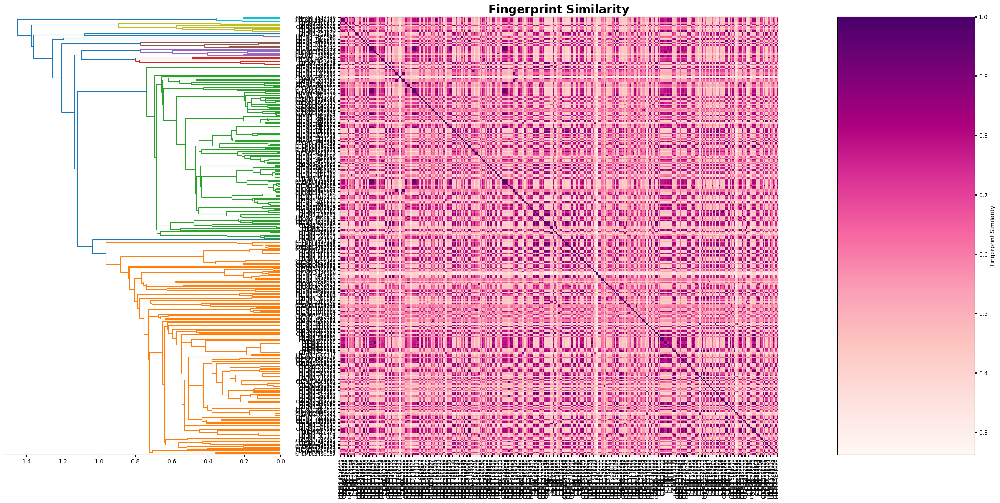

In [85]:
figure= plt.figure(figsize=(30,30))
gs1 = gridspec.GridSpec(2,7)
gs1.update(wspace=0.01)
ax1 = plt.subplot(gs1[0:-1, :2])
dendrogram(linked, orientation='left', distance_sort='descending',show_leaf_counts=True,no_labels=True)
ax1.spines['left'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.spines['right'].set_visible(False)

ax2 = plt.subplot(gs1[0:-1,2:6])
f=ax2.imshow (hmap, cmap='RdPu', interpolation='nearest')

ax2.set_title('Fingerprint Similarity',fontsize=20,weight='bold')
ax2.set_xticks (range(len(new_data)))
ax2.set_yticks (range(len(new_data)))
ax2.set_xticklabels (new_data,rotation=90,size=8)
ax2.set_yticklabels (new_data,size=8)

ax3 = plt.subplot(gs1[0:-1,6:7])
m=plt.colorbar(f,cax=ax3,shrink=0.75,orientation='vertical',spacing='uniform',pad=0.01)
m.set_label ('Fingerprint Similarity')

plt.tick_params ('both',width=2)
plt.grid(False)
plt.plot()
plt.savefig('hcl.png', dpi=600)
[]

# Murcko Fragments

In [94]:
def find_terminal_atoms(mol):
    
    """ 
    This function finds terminal atoms in the structure.
    
    Args:
        mol: Mol objects 
    """
    strt = []
    for a in mol.GetAtoms():
        if len(a.GetBonds()) == 1:
            strt.append(a)
    return strt

In [95]:
def top20Frequent(a):
    """ 
    This function is to assess top 20 most frequent Murcko fragments seen in the list.
 
    Args:
        a: Smile of Murcko fragment 
        
    Returns:
        Giving the 20 most frequent Murcko fragments.
    """
    freq = {}
    for num in a:
        if num in freq and len(num)>1:
            freq[num] = freq[num] + 1
        else:
            freq[num] = 1
    collection = collections.defaultdict(list)
    for e in freq:
        f = freq[e]
        collection[f].append(e)
    res = []
    count = len(a)  # the upper limit for res
    while len(res) < 10:
        if collection[count]:
            res += collection[count]
        count -= 1
    return res

In [96]:
def draw_top20Frequent(sol,counting,smis):
   
    """ 
    This function draws the 20 most seen structures, legends show how many times do they appear in the list 
  
    Args:
        sol: Smile list of top 20 most frequent Murcko fragments seen in a list
        counting: Counts number of occurences of the structures in the list
        smis: MolFromSmiles to count frequencies
        v_f: Calculation of frequencies
        ls_str: String version of frequencies to make them labels
        
    Returns:
        Structure images are given with their frequencies
        
    """
  
    smis= [Chem.MolFromSmiles(solut) for solut in sol] #Chem.MolFromSmiles of Murcko fragments to depict them in images
    for mol in smis:
        rdDepictor.Compute2DCoords(mol) 
    v_f=[counting[x] for x in sol]
    ls_str = [str(x) for x in v_f]
    drawing=Draw.MolsToGridImage(smis[:5],legends=ls_str[:5],subImgSize=(250,250),molsPerRow=5,returnPNG=False)
    return drawing

# MurckoScaffold 

In [97]:
# Getting Scaffold structures using MurckoScaffold function from Rdkit
list_MurckoScaffold=[]
for mol in list_mol:
    if mol:
        core_2 =Chem.MolToSmiles(MurckoScaffold.GetScaffoldForMol(mol))
        list_MurckoScaffold.append(core_2)
print(list_MurckoScaffold[0:3])

['O=C(OCC(OC(=O)C12C[C@H]3C[C@@H](C1)C[C@@H](C2)C3)C1=Cc2cc3ccc(cc4ccc(cc5nc(cc1n2)C=C5C(COC(=O)C12C[C@H]5C[C@@H](C1)C[C@@H](C2)C5)OC(=O)C12C[C@H]5C[C@@H](C1)C[C@@H](C2)C5)[nH]4)[nH]3)C12C[C@H]3C[C@@H](C1)C[C@@H](C2)C3', 'C1=Cc2cc3ccc(cc4nc(cc5ccc(cc1n2)[nH]5)CC4)[nH]3', 'C1=Cc2cc3ccc(cc4nc(cc5ccc(cc1n2)[nH]5)CC4)[nH]3']


In [98]:
#Calculating frequencies of General Murcko Fragments; how many times do they occur in the list?
count_scaff = {}
for n in list_MurckoScaffold:
    count_scaff[n] = count_scaff.get(n, 0) + 1

In [99]:
# Getting Smiles of top 20 most frequent Murcko Scaffolds
solution_MurckoScaffold= top20Frequent(list_MurckoScaffold)
print(solution_MurckoScaffold[0:3])

['C1=Cc2nc1c(-c1ccccc1)c1ccc([nH]1)c(-c1ccccc1)c1nc(c(-c3ccccc3)c3ccc([nH]3)c2-c2ccccc2)C=C1', 'C1=Cc2cc3ccc(cc4nc(cc5ccc(cc1n2)[nH]5)CC4)[nH]3', 'O=C1Cc2c3nc(cc4ccc(cc5nc(cc6cc1c2[nH]6)C=C5)[nH]4)CC3']


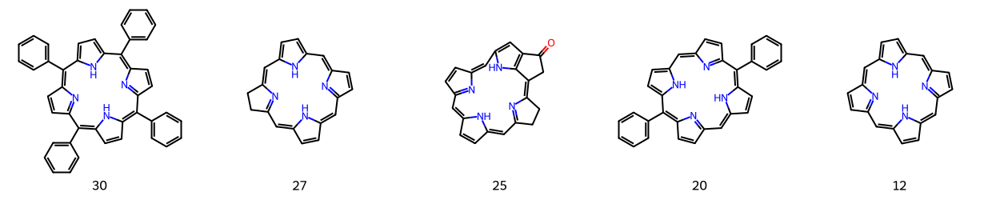

In [100]:
draw_top20Frequent(solution_MurckoScaffold,count_scaff,list_MurckoScaffold)

In [161]:
import pandas as pd
from rdkit import Chem
from rdkit.Chem.Scaffolds import MurckoScaffold

# Porphyrin DataFrame'in SMILES ve pIC50 sütunları
smiles_list = porph["Smiles"].tolist()
pIC50_list = porph["pIC$_5$$_0$"].tolist()

# Molekülleri RDKit formatına çevir


# Murcko Scaffold'larını hesapla
murcko_dict = {}
for mol, pIC50 in zip(list_mol, pIC50_list):
    if mol:
        murcko_smi = Chem.MolToSmiles(MurckoScaffold.GetScaffoldForMol(mol))
        if murcko_smi not in murcko_dict:
            murcko_dict[murcko_smi] = []
        murcko_dict[murcko_smi].append(pIC50)

# En sık görülen Murcko iskeletlerini al
solution_MurckoScaffold = top20Frequent(list(murcko_dict.keys()))

# İlk 3 Murcko Scaffold’un pIC50 aralıklarını bul
murcko_pIC50_ranges = {}
for scaffold in solution_MurckoScaffold[:5]:
    if scaffold in murcko_dict:
        min_pIC50 = min(murcko_dict[scaffold])
        max_pIC50 = max(murcko_dict[scaffold])
        murcko_pIC50_ranges[scaffold] = (min_pIC50, max_pIC50)

# Sonucu yazdır
print(murcko_pIC50_ranges)


{'O=C(OCC(OC(=O)C12C[C@H]3C[C@@H](C1)C[C@@H](C2)C3)C1=Cc2nc1cc1nc(cc3ccc(cc4ccc(c2)[nH]4)[nH]3)C(C(COC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3)C4)OC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3)C4)=C1)C12C[C@H]3C[C@@H](C1)C[C@@H](C2)C3': (5.0, 5.0), 'C1=Cc2cc3ccc(cc4CCc(n4)cc4ccc(cc1n2)[nH]4)[nH]3': (2.3, 10.64), 'C1=Cc2nc1cc1nc(cc3ccc(cc4ccc(c2)[nH]4)[nH]3)C=C1': (7.49, 9.4), 'C1=Cc2cc3c(/C=C/c4ccc5ccccc5n4)cc(cc4CCc(n4)cc4ccc(cc1n2)[nH]4)[nH]3': (9.34, 9.34), 'C1=Cc2nc1c(-c1cc[nH+]cc1)c1nc(c(-c3cc[nH+]cc3)c3ccc([nH]3)c(-c3cc[nH+]cc3)c3ccc(c2-c2cc[nH+]cc2)[nH]3)C=C1': (0.0, 9.89)}


In [151]:
len(list_murcko_mol)

317

In [152]:
pIC50_values = df_with_200_descriptors['pIC$_5$$_0$'].tolist()

In [156]:
min(df_with_200_descriptors['pIC$_5$$_0$']) # min pCI50 value in db

1.9

In [157]:
max(df_with_200_descriptors['pIC$_5$$_0$'])

10.4

# Bemis Murcko

In [102]:
def BemisMurckoFramework(mol):
    """ 
    This function removes hydrogen and terminal R groups from the structure to obtain General Murcko Framework.
    It also switches all non single bonds with single bonds. 
    
    Args:
        mol: Mol objects 
        
    Returns:
        Giving mol objects after General Murcko fragmentation.
    """
    Chem.Kekulize(mol)
    only_HA = rdkit.Chem.rdmolops.RemoveHs(mol) # keep only Heavy Atoms (HA)
    rw_mol = Chem.RWMol(only_HA) # switch all HA to Carbon
    for i in range(rw_mol.GetNumAtoms()):
        rw_mol.ReplaceAtom(i, Chem.Atom(6))
    non_single_bonds = []  # switch all non single bonds to single
    for b in rw_mol.GetBonds():
        if b.GetBondType() != Chem.BondType.SINGLE:
            non_single_bonds.append(b)
    for b in non_single_bonds:
        j = b.GetBeginAtomIdx()
        k = b.GetEndAtomIdx()
        rw_mol.RemoveBond(j, k)
        rw_mol.AddBond(j, k, Chem.BondType.SINGLE)
    
    terminal_atoms = find_terminal_atoms(rw_mol) # as long as there are terminal atoms, remove them
    while terminal_atoms != []:
        for a in terminal_atoms:
            for b in a.GetBonds():
                rw_mol.RemoveBond(b.GetBeginAtomIdx(), b.GetEndAtomIdx())
            rw_mol.RemoveAtom(a.GetIdx())
        terminal_atoms = find_terminal_atoms(rw_mol)
    return rw_mol.GetMol()

In [103]:
#Smiles of bemis Murcko Fragments
List_Bemis_Murcko=[]
for n in list_mol:
    if n:
        List_Bemis_Murcko.append(Chem.MolToSmiles(BemisMurckoFramework(n), kekuleSmiles=True))
print(List_Bemis_Murcko [0:3])

['C(CC(CCC12CC3CC(CC(C3)C1)C2)C1CC2CC3CCC(CC4CCC(C4)CC4CC(CC1C2)CC4C(CCCC12CC4CC(CC(C4)C1)C2)CCC12CC4CC(CC(C4)C1)C2)C3)CC12CC3CC(CC(C3)C1)C2', 'C1CC2CC1CC1CCC(C1)CC1CCC(C1)CC1CCC(C1)C2', 'C1CC2CC1CC1CCC(C1)CC1CCC(C1)CC1CCC(C1)C2']


In [104]:
#Calculating frequencies of General Murcko Fragments; how many times do they occur in the list?
count_Bemis = {}
for n in List_Bemis_Murcko:
    count_Bemis[n] = count_Bemis.get(n, 0) + 1

In [105]:
List_B=[i for i in count_Bemis.values()]


In [106]:
# Getting Smiles of top 20 most frequent Murcko General Fragments
solution_Bemis= top20Frequent(List_Bemis_Murcko)
print(solution_Bemis)

['C1CCC(C2C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC2C3)CC1', 'C1CC2CC1CC1CCC(C1)CC1CCC(C1)CC1CCC(C1)C2', 'C1CC2CC1CC1CCC(C1)CC1CC3CCC(C4CCC(C2)C4)C3C1', 'C1CCC(C2C3CCC(CC4CCC(C4)C(C4CCCCC4)C4CCC(CC5CCC2C5)C4)C3)CC1', 'C.C.C.C.C1CCC(C2C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC2C3)CC1', 'C.C.C1CCC(C2C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC2C3)CC1', 'C.C.C1CCC(C2C3CCC(CC4CCC(C4)C(C4CCCCC4)C4CCC(CC5CCC2C5)C4)C3)CC1', 'C1CCC(C2C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CC(C4CC5CCCC5CC43)C(C3CCCCC3)C3CCC2C3)CC1', 'C1CCC(C2C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CCC2C3)CC1.C1CCCCC1.C1CCCCC1.C1CCCCC1.C1CCCCC1', 'C1CCC2C3CC4CCC(CC5CCC(C5)CC5CCC(C5)CC(C3)C2C1)C4', 'C1CCC(C2C3CCC(C3)C(C3CCCCC3)C3CCC(C3)C(C3CCCCC3)C3CC(CC3C3CCCC3)C(C3CCCCC3)C3CCC2C3)CC1', 'C1CCC(C2C3CCC(CC4CCC(C4)C(C4CCCCC4)C4CC(CC5CCC2C5)C2CC5CCCC5CC24)C3)CC1', 'C1CCC(CCCCC2CC3CC4CCC(CC5CCC(C5)CC5CCC(C5)CC2C3)C4)CC1', 'C1CCC2CCCC(C2)C2CCC

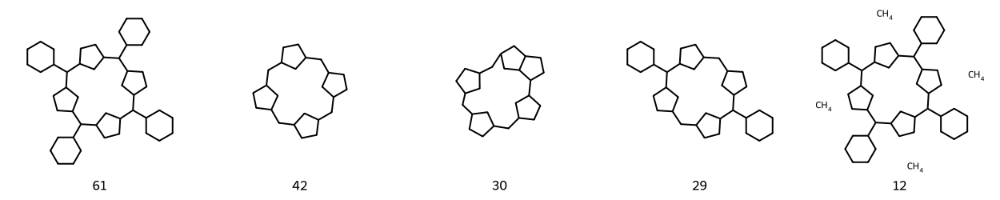

In [107]:
draw_top20Frequent(solution_Bemis,count_Bemis,List_Bemis_Murcko)

In [108]:
porph=porph_cleaned

In [335]:
porph

,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,Standard Relation,...,Target Type,Document ChEMBL ID,Source ID,Source Description,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value
0,CHEMBL1325592,PROTOPORPHYRIN,-1.00,562.67,2.00,7.50,SID50106857,C=CC1=C(C)c2cc3[nH]c(cc4nc(cc5[nH]c(cc1n2)c(C)...,Potency,'=',...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,CHEMBL441738,AFAMELANOTIDE,4.00,1646.87,NaN,NaN,NDP-MSH,CCCC[C@H](NC(=O)[C@H](CO)NC(=O)[C@H](Cc1ccc(O)...,EC50,'=',...,SINGLE PROTEIN,CHEMBL1136069,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,CHEMBL3307715,NaN,NaN,NaN
2,CHEMBL441738,AFAMELANOTIDE,4.00,1646.87,NaN,NaN,NDP-MSH,CCCC[C@H](NC(=O)[C@H](CO)NC(=O)[C@H](Cc1ccc(O)...,EC50,'=',...,SINGLE PROTEIN,CHEMBL1136069,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,CHEMBL3307715,NaN,NaN,NaN
3,CHEMBL71,CHLORPROMAZINE,4.00,318.87,0.00,4.89,Chlorpromazine,CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21,IC50,'=',...,SINGLE PROTEIN,CHEMBL1136167,1.00,Scientific Literature,Bioorg Med Chem Lett,2003.00,NaN,NaN,NaN,NaN
4,CHEMBL500593,NaN,NaN,622.72,2.00,6.31,6,C=Cc1c(C)c2cc3nc(c4c5[nH]c(cc6nc(cc1[nH]2)C(C)...,ED50,'=',...,CELL-LINE,CHEMBL1155723,1.00,Scientific Literature,J Nat Prod,2001.00,CHEMBL3308035,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12400,CHEMBL71,CHLORPROMAZINE,4.00,318.87,0.00,4.89,chlorpromazine,CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21,RETIRBC,'=',...,ORGANISM,CHEMBL3885861,11.00,Open TG-GATEs,NaN,NaN,NaN,ACTIVITY_TEST: RETIRBC (Reticulocytes/Erythroc...,NaN,NaN
12401,CHEMBL71,CHLORPROMAZINE,4.00,318.87,0.00,4.89,chlorpromazine,CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21,APTT,'=',...,ORGANISM,CHEMBL3885861,11.00,Open TG-GATEs,NaN,NaN,NaN,ACTIVITY_TEST: APTT (Activated Partial Thrombo...,NaN,NaN
12402,CHEMBL71,CHLORPROMAZINE,4.00,318.87,0.00,4.89,Chlorpromazine,CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21,Ki,'=',...,UNCHECKED,CHEMBL5360673,1.00,Scientific Literature,J Med Chem,2023.00,NaN,TIME = 0.5 hr,ANTAGONIST,NaN
12403,CHEMBL71,CHLORPROMAZINE,4.00,318.87,0.00,4.89,CPM,CN(C)CCCN1c2ccccc2Sc2ccc(Cl)cc21,Activity,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Machine Learning

In [109]:
# Mol objects of structures for similarity search (Mol notation conversion needed)
porph_mol=[]
for i in porph['Smiles']:
    mol = Chem.MolFromSmiles(i)
    porph_mol.append(mol)
porph['mol']= porph_mol
porph[0:3]

,index,Molecule ChEMBL ID,Molecule Name,Molecule Max Phase,Molecular Weight,#RO5 Violations,AlogP,Compound Key,Smiles,Standard Type,...,Document Journal,Document Year,Cell ChEMBL ID,Properties,Action Type,Standard Text Value,activity_status,pIC$_5$$_0$,z_score,mol
0,16,CHEMBL268410,NaN,NaN,1279.63,NaN,NaN,7,CC1=C(C(COC(=O)C23C[C@H]4C[C@@H](C2)C[C@@H](C3...,IC50,...,J Med Chem,1992.00,NaN,NaN,NaN,NaN,pIC$_5$$_0$ active,5.30,-0.35,<rdkit.Chem.rdchem.Mol object at 0x000001BD391...
1,39,CHEMBL4741802,NaN,NaN,813.95,3.00,7.97,3a,CCCCCCOC(C)c1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O...,IC50,...,Eur J Med Chem,2020.00,CHEMBL3307651,TIME = 48.0 hr,NaN,NaN,pIC$_5$$_0$ inactive,3.75,-1.45,<rdkit.Chem.rdchem.Mol object at 0x000001BD391...
2,40,CHEMBL2111186,TALAPORFIN,3.00,711.77,3.00,5.95,Talaporfin,C=Cc1c(C)c2cc3nc(c(CC(=O)N[C@@H](CC(=O)O)C(=O)...,IC50,...,Eur J Med Chem,2020.00,CHEMBL3307762,TIME = 48.0 hr,NaN,NaN,pIC$_5$$_0$ inactive,4.85,-0.67,<rdkit.Chem.rdchem.Mol object at 0x000001BD391...


In [110]:
FP = [AllChem.GetMorganFingerprintAsBitVect(mol, 2, 1024) for mol in porph.mol]
df_FP = pd.DataFrame(np.array(FP))
df_FP.head()

[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerator
[00:58:20] DEPRECATION WARNING: please use MorganGenerat

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
0,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,1,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
3,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,1,1,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0


In [111]:
X=df_FP

In [112]:
# Assuming df_cleaned is your DataFrame and 'pIC50' is the target column
y = porph['pIC$_5$$_0$']  # Target variable
 # Features, dropping the target column

In [366]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2)

In [123]:
reg = LazyRegressor(verbose=0, ignore_warnings=False, custom_metric=None)
models_2, predictions = reg.fit(X_train, X_test, y_train, y_test)
print(models_2)

 57%|█████▋    | 24/42 [00:48<00:40,  2.24s/it]

LassoLarsIC model failed to execute
You are using LassoLarsIC in the case where the number of samples is smaller than the number of features. In this setting, getting a good estimate for the variance of the noise is not possible. Provide an estimate of the noise variance in the constructor.


 76%|███████▌  | 32/42 [00:51<00:05,  1.98it/s]

RANSACRegressor model failed to execute
`min_samples` may not be larger than number of samples: n_samples = 253.


100%|██████████| 42/42 [00:58<00:00,  1.76it/s]

XGBRegressor model failed to execute
'super' object has no attribute '__sklearn_tags__'
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001447 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 420
[LightGBM] [Info] Number of data points in the train set: 253, number of used features: 140
[LightGBM] [Info] Start training from score 5.798498
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain,

100%|██████████| 42/42 [00:58<00:00,  1.40s/it]

                                             Adjusted R-Squared  \
Model                                                             
Lars                          100821860608669209757634002944.00   
LarsCV                              860234279722708254064640.00   
SGDRegressor                                   4783775823032.37   
KernelRidge                                                2.05   
GaussianProcessRegressor                                   1.91   
MLPRegressor                                               1.13   
LinearRegression                                           1.10   
TransformedTargetRegressor                                 1.10   
QuantileRegressor                                          1.07   
LassoLars                                                  1.07   
Lasso                                                      1.07   
DummyRegressor                                             1.07   
ElasticNet                                                 1.0

In [328]:
models_2

,Adjusted R-Squared,R-Squared,RMSE,Time Taken
Model,,,,
Lars,100821860608669209757634002944.00,-1537933461030652421508721278976.00,1896419890087486.00,0.34
LarsCV,860234279722708254064640.00,-13121986393865437747085312.00,5539435631086.85,3.25
SGDRegressor,4783775823032.37,-72971564538620.33,13062988.89,0.13
KernelRidge,2.05,-14.97,6.11,0.06
GaussianProcessRegressor,1.91,-12.91,5.70,0.12
MLPRegressor,1.13,-0.96,2.14,0.87
LinearRegression,1.10,-0.53,1.89,0.12
TransformedTargetRegressor,1.10,-0.53,1.89,2.56
QuantileRegressor,1.07,-0.01,1.53,0.53


In [370]:
from sklearn.model_selection import cross_val_score

from sklearn.linear_model import TweedieRegressor
model =TweedieRegressor()

# Perform 5-fold cross-validation
scores = cross_val_score(model, X_train, y_train, cv=5, scoring='r2')

# Print mean R² score
print(f"Mean R² score from 5-fold CV: {scores.mean():.3f}")

Mean R² score from 5-fold CV: 0.215


# Classification (Active-Non_active)

In [388]:
y = porph['activity'] 

In [125]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [127]:
# LazyPredict sınıflandırıcıyı başlat ve eğit
clf = LazyClassifier(verbose=0, ignore_warnings=True, custom_metric=None)
models, predictions = clf.fit(X_train, X_test, y_train, y_test)

# Sonuçları yazdır
print(models)

100%|██████████| 32/32 [00:03<00:00,  8.13it/s]

[LightGBM] [Info] Number of positive: 165, number of negative: 88
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001149 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 432
[LightGBM] [Info] Number of data points in the train set: 253, number of used features: 144
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.652174 -> initscore=0.628609
[LightGBM] [Info] Start training from score 0.628609
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

In [329]:
models

,Accuracy,Balanced Accuracy,ROC AUC,F1 Score,Time Taken
Model,,,,,
Perceptron,0.81,0.80,NaN,0.82,0.04
LogisticRegression,0.83,0.80,0.80,0.83,0.05
ExtraTreesClassifier,0.80,0.77,0.77,0.80,0.26
KNeighborsClassifier,0.72,0.77,0.77,0.73,0.04
RandomForestClassifier,0.81,0.77,0.77,0.81,0.30
PassiveAggressiveClassifier,0.78,0.76,NaN,0.79,0.05
NearestCentroid,0.69,0.75,0.75,0.70,0.08
BernoulliNB,0.66,0.71,NaN,0.67,0.04
BaggingClassifier,0.75,0.71,0.71,0.75,0.21


In [391]:
import numpy as np
from sklearn.datasets import load_iris
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier

# Initialize the model
model = RandomForestClassifier(n_estimators=100)

# Perform cross-validation
scores = cross_val_score(model, X, y, cv=5)  # 5-fold cross-validation

# Output the results
print("Cross-Validation Scores:", scores)
print("Mean Score:", np.mean(scores))

Cross-Validation Scores: [0.796875   0.671875   0.79365079 0.74603175 0.6031746 ]
Mean Score: 0.7223214285714286


In [392]:
model = LogisticRegression()

# Perform 5-fold cross-validation
scores = cross_val_score(model, X, y, cv=5)

# Output results
print("Cross-Validation Scores:", scores)
print("Mean Score:", np.mean(scores))

Cross-Validation Scores: [0.75       0.65625    0.74603175 0.6984127  0.6031746 ]
Mean Score: 0.6907738095238096


[(0.0, 1.0)]

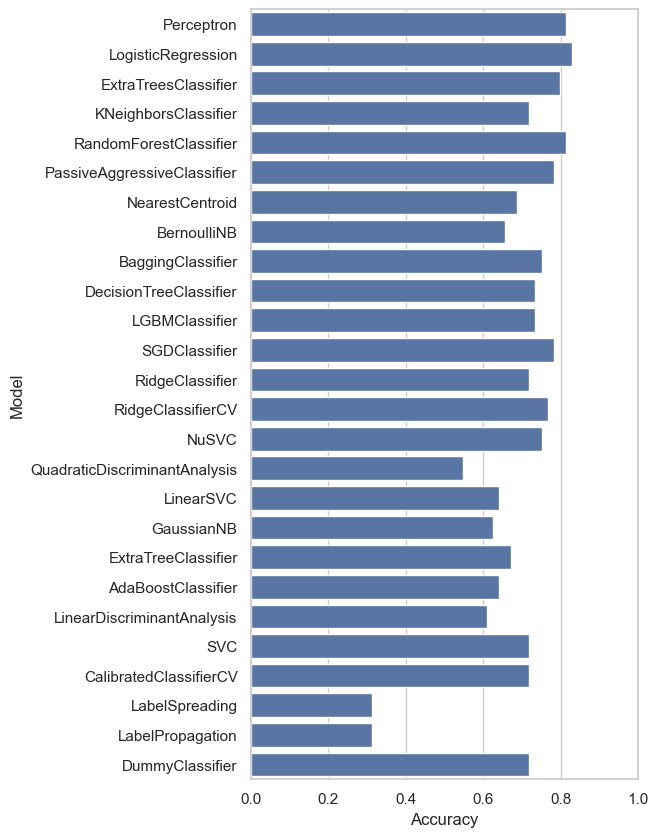

In [129]:
# 
plt.figure(figsize=(5, 10))
sns.set_theme(style="whitegrid")
ax = sns.barplot(y=models.index, x="Accuracy", data=models)
ax.set(xlim=(0, 1))

# TUMOR RESPONSE

In [113]:
porph = pd.read_csv('porphyrin.csv')

In [114]:
t_res=porph[(porph['Standard Type']== 'Tumor response') | (porph['Standard Type']=='Tumor cure')]

In [115]:
t_res=t_res[~t_res.duplicated(['Molecule ChEMBL ID', 'Document ChEMBL ID'], keep=False)]
t_res['Standard Value'].fillna(0, inplace = True)

In [116]:
t_res.sort_values(by=['Standard Value'], ascending=False, inplace=True)

In [117]:
len(t_res)

11

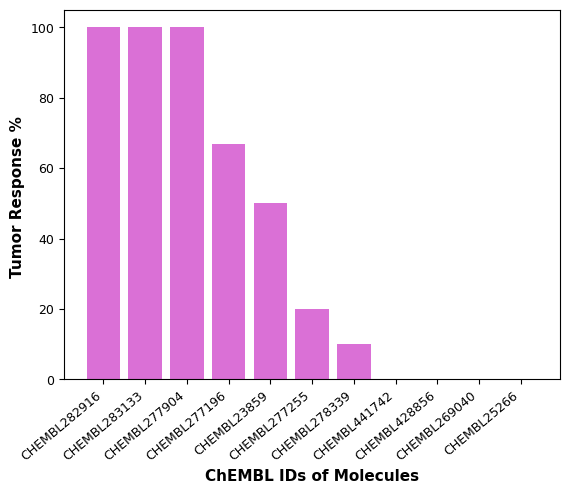

In [118]:
x=plt.bar(t_res['Molecule ChEMBL ID'], t_res['Standard Value'], align='center',color ="#DA70D6"
)
plt.xticks(rotation=40,fontsize='9',horizontalalignment='right')
plt.yticks(fontsize='9')
plt.xlabel('ChEMBL IDs of Molecules', fontweight='bold', color='black',
   fontsize='11', horizontalalignment='center')
plt.ylabel('Tumor Response % ', fontweight='bold', color='black',
   fontsize='11', horizontalalignment='center')
plt.savefig('tumor_resp.png', dpi=600)
plt.grid(False);

In [213]:

tres_mol=[]
for i in t_res['Smiles']:
    mol = Chem.MolFromSmiles(i)
    tres_mol.append(mol)


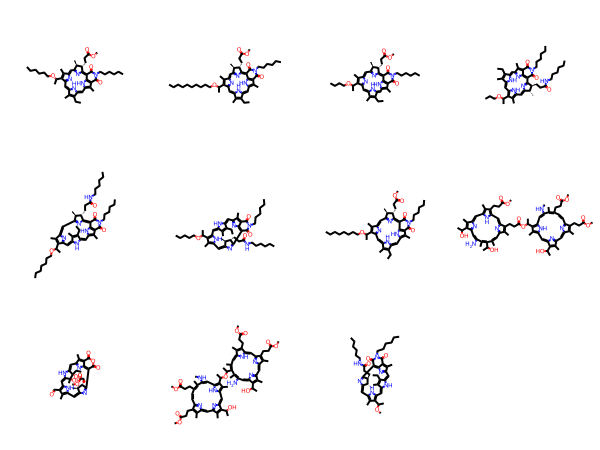

In [232]:
Draw.MolsToGridImage(tres_mol,molsPerRow=4,subImgSize=(150,150))

In [322]:
freq1=tres_mol[4]
rdDepictor.Compute2DCoords(freq1)

0

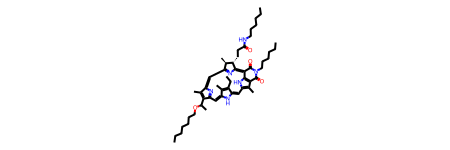

In [325]:
freq1

In [326]:
img = Draw.MolToImage(freq1, size=(300, 300)) 

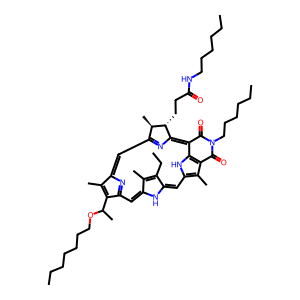

In [327]:
img

In [317]:
# Create a drawer with custom options
drawer = Draw.MolDraw2DSVG(150, 150)  # Example drawer
options = drawer.drawOptions()
options.bondLineWidth = 0.5  # Adjust line width
options.additionalAtomLabelPadding = 0.05  # Adjust atom label spacing
options.useBWAtomPalette()  # Optional: Black-and-white palette
options.fontSize = 0.5  # Reduce font size for atom labels

